# Predicting COVID-19 from chest X-ray images

## Setting the Environment

In [1]:
# start JupyterLab in cmd: jupyter lab --ServerApp.iopub_data_rate_limit=10000000
# start Jupyter Notebook in cmd: jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000
#!pip3 install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
#!pip install seaborn
#!pip install scikit-learn

In [2]:
import torch

if torch.cuda.is_available():
    device = torch.device("cuda")
    print(f"CUDA is available. Device: {torch.cuda.get_device_name(0)}")
else:
    device = torch.device("cpu")
    print("CUDA is not available. Using CPU.")

CUDA is available. Device: NVIDIA GeForce GTX 1660 Ti with Max-Q Design


## Setting the Data

### Dataset Structure
data/ <br>
&emsp;train/ <br>
&emsp;&emsp;covid/ <br>
&emsp;&emsp;non/ <br>
&emsp;test/ <br>
&emsp;&emsp;covid/ <br>
&emsp;&emsp;non/ <br>


In [3]:
# Verifiing that all files in the dataset can be opened and are images
from PIL import Image
import os

def check_images(folder_path):
    i = 0
    for subdir, dirs, files in os.walk(folder_path):
        for file in files:
            i += 1
            try:
                img_path = os.path.join(subdir, file)
                img = Image.open(img_path)
                img.verify()
            except (IOError, SyntaxError) as e:
                print(f'Bad file:', img_path)
    return i

total_train_files = check_images('data/train')
print(f"Total train files checked: {total_train_files}")

total_test_files = check_images('data/test')
print(f"Total test files checked: {total_test_files}")

Total train files checked: 2504
Total test files checked: 3100


In [4]:
# Cheking image shapes
from collections import defaultdict

def check_image_shapes(folder_path):
    dimensions = defaultdict(int)  # Dictionary to store the count of each dimension
    for subdir, dirs, files in os.walk(folder_path):
        for file in files:
            try:
                img_path = os.path.join(subdir, file)
                with Image.open(img_path) as img:
                    size = img.size  # Get the dimensions of the image
                    dimensions[size] += 1  # Increment the count of this dimension
            except Exception as e:
                print(f"Error opening {img_path}: {e}")
    return dimensions

# Example usage
train_dimensions = check_image_shapes('data/train')
test_dimensions = check_image_shapes('data/test')

print("Train image dimensions and counts:")
for dim, count in train_dimensions.items():
    print(f"{dim}: {count}")

print("Test image dimensions and counts:")
for dim, count in test_dimensions.items():
    print(f"{dim}: {count}")

def describe_dimensions(dimensions):
    total_images = sum(dimensions.values())  # Total number of images
    unique_sizes = len(dimensions)  # Number of unique image sizes
    max_freq = max(dimensions.values())  # Maximum frequency of any dimension
    top_dim = max(dimensions, key=dimensions.get)  # Dimension with the maximum frequency
    
    # Calculate max and min dimensions
    max_dim = max(dimensions.keys(), key=lambda x: (x[0]*x[1]))  # Largest dimension by area
    min_dim = min(dimensions.keys(), key=lambda x: (x[0]*x[1]))  # Smallest dimension by area

    print("Count:", total_images)
    print("Unique:", unique_sizes)
    print("Top:", top_dim, "Freq:", max_freq)
    print("Max Dimension (largest area):", max_dim)
    print("Min Dimension (smallest area):", min_dim)

# Describe dimensions
print("\nDescription of Train Dimensions:")
describe_dimensions(train_dimensions)

print("\nDescription of Test Dimensions:")
describe_dimensions(test_dimensions)

Train image dimensions and counts:
(1989, 1482): 1
(477, 411): 1
(508, 500): 1
(439, 362): 1
(445, 362): 1
(2200, 2195): 1
(1024, 842): 2
(2059, 1483): 1
(1696, 1403): 1
(900, 714): 1
(1726, 1552): 1
(1300, 1127): 1
(1001, 776): 1
(4248, 3480): 1
(1884, 1447): 1
(1024, 1024): 3
(4280, 3520): 1
(1727, 1442): 1
(443, 366): 1
(442, 368): 1
(443, 370): 2
(444, 368): 1
(1020, 1024): 1
(1723, 1466): 1
(3039, 2465): 1
(1384, 1326): 1
(1235, 1024): 1
(1160, 1024): 1
(1992, 1285): 1
(4200, 3408): 1
(1799, 1472): 1
(657, 657): 1
(1592, 1448): 1
(651, 659): 1
(679, 497): 1
(224, 224): 420
(2150, 1648): 1
(1989, 1463): 1
(2376, 2880): 1
(2140, 1760): 1
(2800, 3368): 1
(1446, 1262): 1
(1205, 1395): 2
(2169, 1852): 1
(2500, 2048): 2
(3408, 2800): 1
(814, 733): 1
(957, 852): 1
(640, 543): 1
(640, 574): 1
(2972, 2840): 1
(450, 389): 1
(862, 605): 1
(756, 605): 1
(1598, 1550): 1
(444, 369): 1
(446, 366): 1
(442, 367): 1
(1677, 1611): 1
(1524, 1516): 1
(1261, 982): 1
(1210, 1282): 1
(1667, 1240): 1
(683

# Preprocessing Data

## 'Train/covid' data augmentation 5 times

In [5]:
# from torchvision import transforms

# # Define the path to the original COVID data
# covid_path = 'data/train/covid/'

# # Ensure the directory exists
# os.makedirs(covid_path, exist_ok=True)

# # Define transformations for augmentation
# transform = transforms.Compose([
#     transforms.Resize((224, 224)),
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomRotation(5),
#     # transforms.RandomAffine(degrees=0, translate=(0.1, 0.1), scale=(0.9, 1.1)),
#     transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),
#     transforms.ToTensor()  # Converts to tensor for augmentation
# ])

# # Function to save augmented images
# def save_transformed_images(img_path, transform, num_copies=5):
#     img = Image.open(img_path).convert('RGB')
#     for i in range(num_copies):
#         transformed_tensor = transform(img)
#         # Convert tensor to PIL Image and save
#         save_img = transforms.ToPILImage()(transformed_tensor)
#         save_img.save(os.path.join(covid_path, f"aug_{i}_{os.path.basename(img_path)}"))

# # Process each image in the original COVID directory
# for file in os.listdir(covid_path):
#     img_path = os.path.join(covid_path, file)
#     save_transformed_images(img_path, transform)


## Batch size

In [6]:
batch_size = 32 # 20; 64, 128

## Train Loader

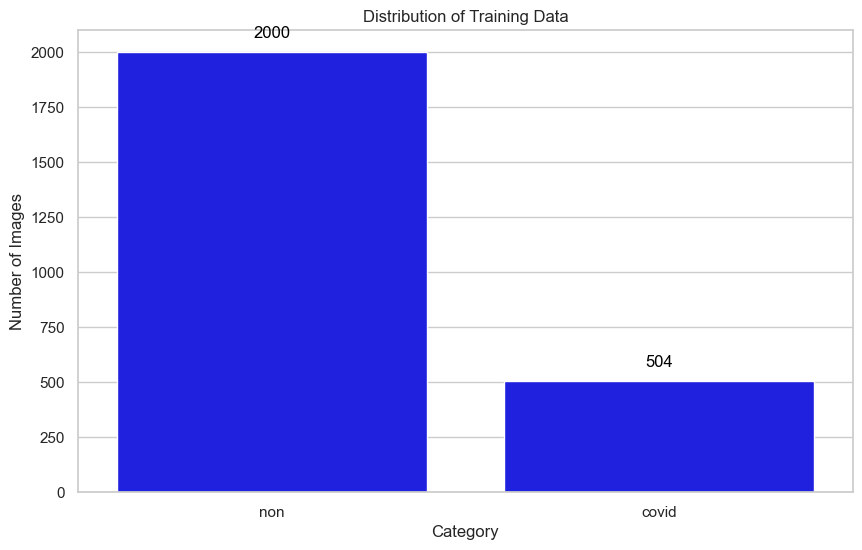

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from collections import defaultdict

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Path to the dataset
train_data_path = 'data/train/'

# Create dataset
train_dataset = datasets.ImageFolder(root=train_data_path, transform=transform)

# Create data loader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)

# Count images in each category
class_counts = defaultdict(int)
for inputs, labels in train_loader:
    for label in labels:
        class_name = train_dataset.classes[label]
        class_counts[class_name] += 1

# Plotting
categories = list(class_counts.keys())
counts = list(class_counts.values())

sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
bar_plot = sns.barplot(x=categories, y=counts, color='blue')
plt.title('Distribution of Training Data')
plt.xlabel('Category')
plt.ylabel('Number of Images')

# Adding numbers to the bars
for bar in bar_plot.patches:
    bar_plot.annotate(format(bar.get_height(), '.0f'),
                      (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                      ha='center', va='bottom', 
                      color='black', xytext=(0,8),
                      textcoords='offset points')

plt.show()


## Validation Loader

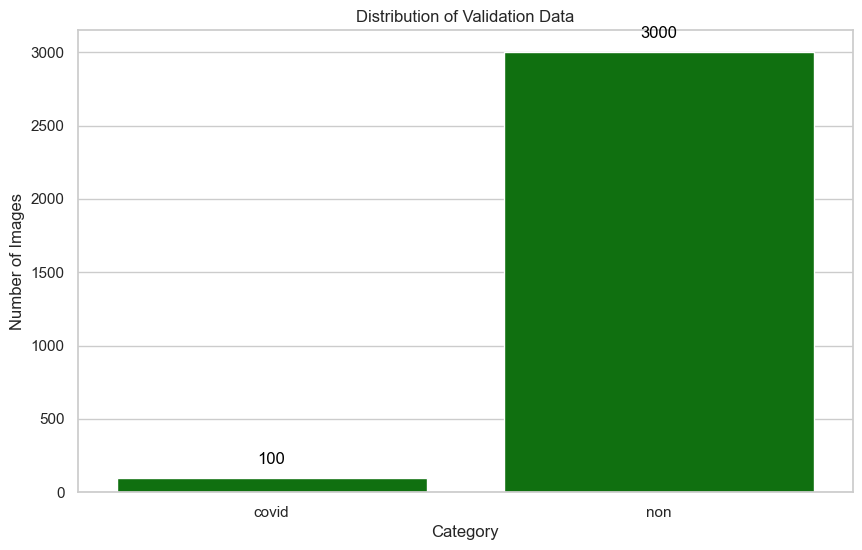

In [8]:
# Define transformations for the validation dataset
val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Path to the test dataset which will be used for validation
test_data_path = 'data/test/'

# Create the validation dataset
val_dataset = datasets.ImageFolder(root=test_data_path, transform=val_transform)

# Create the validation data loader
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

# Count images in each category for validation
val_class_counts = defaultdict(int)
for inputs, labels in val_loader:
    for label in labels:
        class_name = val_dataset.classes[label]
        val_class_counts[class_name] += 1

# Plotting for validation dataset
val_categories = list(val_class_counts.keys())
val_counts = list(val_class_counts.values())

sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
val_bar_plot = sns.barplot(x=val_categories, y=val_counts, color='green')
plt.title('Distribution of Validation Data')
plt.xlabel('Category')
plt.ylabel('Number of Images')

# Adding numbers to the bars for validation
for bar in val_bar_plot.patches:
    val_bar_plot.annotate(format(bar.get_height(), '.0f'),
                          (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                          ha='center', va='bottom', 
                          color='black', xytext=(0,8),
                          textcoords='offset points')

plt.show()


## Chosen Models
- MobileNetV2 (lecturer's suggestion) <br>
- MobileNetV3 (lecturer's suggestion) <br>
- ResNet50 (a balanced choice in the ResNet family) <br>
- EfficientNet-B0 (offers a good trade-off between efficiency and accuracy) <br>
- DenseNet121 (known for its efficiency in terms of parameters and depth) <br>

In [9]:
import torch
import torch.nn as nn
from torchvision.models import (
    mobilenet_v2, MobileNet_V2_Weights,
    mobilenet_v3_large, MobileNet_V3_Large_Weights,
    resnet50, ResNet50_Weights,
    efficientnet_b0, EfficientNet_B0_Weights,
    densenet121, DenseNet121_Weights
)

def modified_classifier(in_features, num_classes, dropout_rate):
    return nn.Sequential(
        nn.Dropout(p=dropout_rate),
        nn.Linear(in_features, num_classes)
    )

def load_pretrained_models(model_configs):
    models_dict = {}
    for model_name, config in model_configs.items():
        if model_name == 'MobileNetV2':
            model = mobilenet_v2(weights=MobileNet_V2_Weights.DEFAULT)
            for param in model.features.parameters():
                param.requires_grad = False
            model.classifier[1] = modified_classifier(model.classifier[1].in_features, config.num_classes, config.dropout)

        elif model_name == 'MobileNetV3_Large':
            model = mobilenet_v3_large(weights=MobileNet_V3_Large_Weights.DEFAULT)
            for param in model.features.parameters():
                param.requires_grad = False
            model.classifier[3] = modified_classifier(model.classifier[3].in_features, config.num_classes, config.dropout)

        elif model_name == 'ResNet50':
            model = resnet50(weights=ResNet50_Weights.DEFAULT)
            for param in model.parameters():
                param.requires_grad = False
            model.fc = modified_classifier(model.fc.in_features, config.num_classes, config.dropout)

        elif model_name == 'EfficientNet_B0':
            model = efficientnet_b0(weights=EfficientNet_B0_Weights.DEFAULT)
            for param in model.parameters():
                param.requires_grad = False
            model.classifier[1] = modified_classifier(model.classifier[1].in_features, config.num_classes, config.dropout)

        elif model_name == 'DenseNet121':
            model = densenet121(weights=DenseNet121_Weights.DEFAULT)
            for param in model.parameters():
                param.requires_grad = False
            model.classifier = modified_classifier(model.classifier.in_features, config.num_classes, config.dropout)

        optimizer = torch.optim.Adam(
            filter(lambda p: p.requires_grad, model.parameters()),
            lr=config.lr,
            weight_decay=config.weight_decay,
            betas=(0.9, 0.999)
        )
        
        models_dict[model_name] = {'model': model, 'optimizer': optimizer}

    return models_dict


## Early Stopping

In [10]:
class EarlyStopping:
    def __init__(self, patience=20, verbose=False, delta=0, path='best_model.pth', start_epoch=5):
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta
        self.path = path
        self.start_epoch = start_epoch

    def __call__(self, val_loss, model, epoch):
        score = -val_loss

        # Initialize best score at the start of tracking
        if epoch == self.start_epoch:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            return

        if epoch > self.start_epoch:
            # Check if there is a decrease beyond the delta
            if val_loss < self.val_loss_min - self.delta:
                self.best_score = score
                self.save_checkpoint(val_loss, model)
                self.counter = 0
            else:
                self.counter += 1
                if self.verbose:
                    print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
                if self.counter >= self.patience:
                    self.early_stop = True

    def save_checkpoint(self, val_loss, model):
        ''' Saves model when validation loss decreases. '''
        if self.verbose:
            print(f'Validation loss decreased ({self.val_loss_min:.6f} to {val_loss:.6f}). Saving model...')
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss


## Early Stopping Patience 

In [11]:
early_stopping_patience = 20

## Training Models

In [ ]:
from torch.optim import lr_scheduler
from torch.optim.lr_scheduler import ReduceLROnPlateau

def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=50):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    
    # Initialize EarlyStopping and ReduceLROnPlateau
    early_stopping = EarlyStopping(patience=early_stopping_patience, verbose=True, path='best_model.pth', start_epoch=3)
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3)

    # Initialize history tracking
    history = {
        'train_loss': [],
        'val_loss': [],
        'train_accuracy': [],
        'val_accuracy': []
    }

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

        train_loss = running_loss / len(train_loader)
        train_accuracy = 100 * correct / total

        val_loss, val_accuracy = validate_model(model, criterion, val_loader, verbose=False)

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_accuracy'].append(train_accuracy)
        history['val_accuracy'].append(val_accuracy)

        print(f'Epoch [{epoch + 1}/{num_epochs}] - Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%')
        
        scheduler.step(val_loss)
        last_lr = optimizer.param_groups[0]['lr']
        print(f"Current learning rate: {last_lr}")
        
        early_stopping(val_loss, model, epoch)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break

    print('Finished Training')
    model.load_state_dict(torch.load('best_model.pth'))

    return history

In [ ]:
def validate_model(model, criterion, val_loader, verbose=True):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()  # Set model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    avg_val_loss = val_loss / len(val_loader)
    accuracy = 100 * correct / total
    if verbose:
        print(f'Validation Loss: {avg_val_loss:.4f}, Accuracy: {accuracy:.2f}%')
    return avg_val_loss, accuracy

In [13]:
# Visualise History
import matplotlib.pyplot as plt

def plot_history(history):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history['train_loss'], label='Train Loss')
    plt.plot(history['val_loss'], label='Validation Loss')
    plt.title('Loss History')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history['train_accuracy'], label='Train Accuracy')
    plt.plot(history['val_accuracy'], label='Validation Accuracy')
    plt.title('Accuracy History')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.show()



Training MobileNetV2
Epoch [1/100] - Train Loss: 0.5080, Train Accuracy: 76.64%, Val Loss: 0.2569, Val Accuracy: 96.77%
Current learning rate: 0.0001
Epoch [2/100] - Train Loss: 0.3739, Train Accuracy: 80.71%, Val Loss: 0.2095, Val Accuracy: 96.77%
Current learning rate: 0.0001
Epoch [3/100] - Train Loss: 0.3143, Train Accuracy: 85.14%, Val Loss: 0.1832, Val Accuracy: 96.90%
Current learning rate: 0.0001
Epoch [4/100] - Train Loss: 0.2563, Train Accuracy: 90.65%, Val Loss: 0.1619, Val Accuracy: 97.16%
Current learning rate: 0.0001
Validation loss decreased (inf to 0.161931). Saving model...
Epoch [5/100] - Train Loss: 0.2206, Train Accuracy: 93.25%, Val Loss: 0.1472, Val Accuracy: 97.42%
Current learning rate: 0.0001
Validation loss decreased (0.161931 to 0.147181). Saving model...
Epoch [6/100] - Train Loss: 0.2003, Train Accuracy: 94.61%, Val Loss: 0.1398, Val Accuracy: 98.13%
Current learning rate: 0.0001
Validation loss decreased (0.147181 to 0.139780). Saving model...
Epoch [7/10

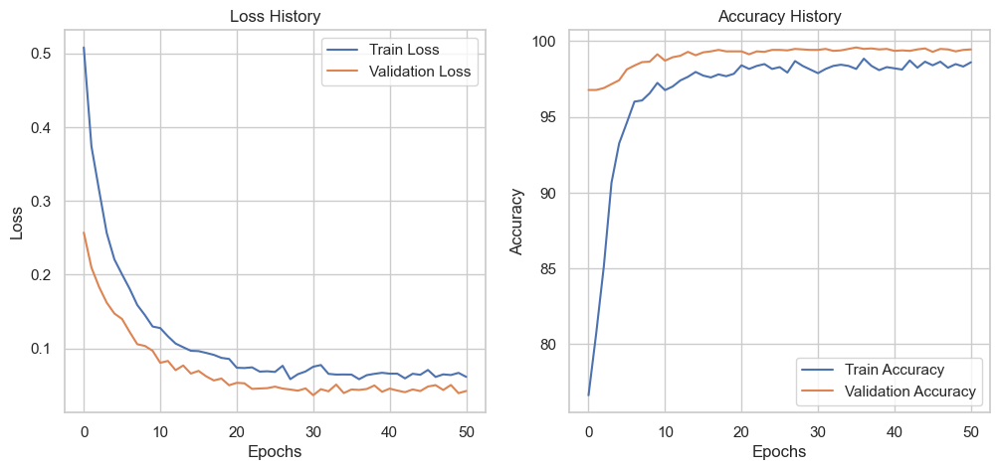

Validation Loss: 0.0364, Accuracy: 99.42%
Final Validation for MobileNetV2 - Loss: 0.0364, Accuracy: 99.42%

Training MobileNetV3_Large
Epoch [1/100] - Train Loss: 0.2963, Train Accuracy: 86.58%, Val Loss: 0.1565, Val Accuracy: 97.84%
Current learning rate: 0.0001
Epoch [2/100] - Train Loss: 0.1173, Train Accuracy: 97.36%, Val Loss: 0.1872, Val Accuracy: 96.74%
Current learning rate: 0.0001
Epoch [3/100] - Train Loss: 0.0648, Train Accuracy: 98.76%, Val Loss: 0.2277, Val Accuracy: 92.48%
Current learning rate: 0.0001
Epoch [4/100] - Train Loss: 0.0465, Train Accuracy: 98.92%, Val Loss: 0.2604, Val Accuracy: 89.42%
Current learning rate: 0.0001
Validation loss decreased (inf to 0.260367). Saving model...
Epoch [5/100] - Train Loss: 0.0324, Train Accuracy: 99.24%, Val Loss: 0.1099, Val Accuracy: 96.58%
Current learning rate: 0.0001
Validation loss decreased (0.260367 to 0.109855). Saving model...
Epoch [6/100] - Train Loss: 0.0270, Train Accuracy: 99.12%, Val Loss: 0.0476, Val Accuracy: 

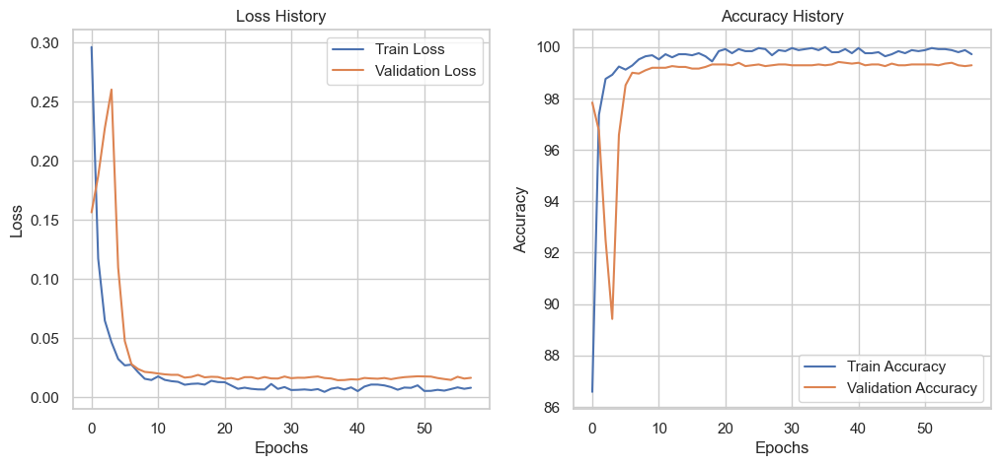

Validation Loss: 0.0144, Accuracy: 99.42%
Final Validation for MobileNetV3_Large - Loss: 0.0144, Accuracy: 99.42%

Training ResNet50
Epoch [1/100] - Train Loss: 0.4687, Train Accuracy: 79.15%, Val Loss: 0.2502, Val Accuracy: 96.77%
Current learning rate: 0.0001
Epoch [2/100] - Train Loss: 0.3595, Train Accuracy: 81.43%, Val Loss: 0.2010, Val Accuracy: 96.84%
Current learning rate: 0.0001
Epoch [3/100] - Train Loss: 0.2956, Train Accuracy: 88.26%, Val Loss: 0.1700, Val Accuracy: 97.03%
Current learning rate: 0.0001
Epoch [4/100] - Train Loss: 0.2541, Train Accuracy: 92.05%, Val Loss: 0.1514, Val Accuracy: 97.23%
Current learning rate: 0.0001
Validation loss decreased (inf to 0.151443). Saving model...
Epoch [5/100] - Train Loss: 0.2177, Train Accuracy: 94.77%, Val Loss: 0.1363, Val Accuracy: 97.19%
Current learning rate: 0.0001
Validation loss decreased (0.151443 to 0.136294). Saving model...
Epoch [6/100] - Train Loss: 0.1899, Train Accuracy: 95.53%, Val Loss: 0.1228, Val Accuracy: 97.

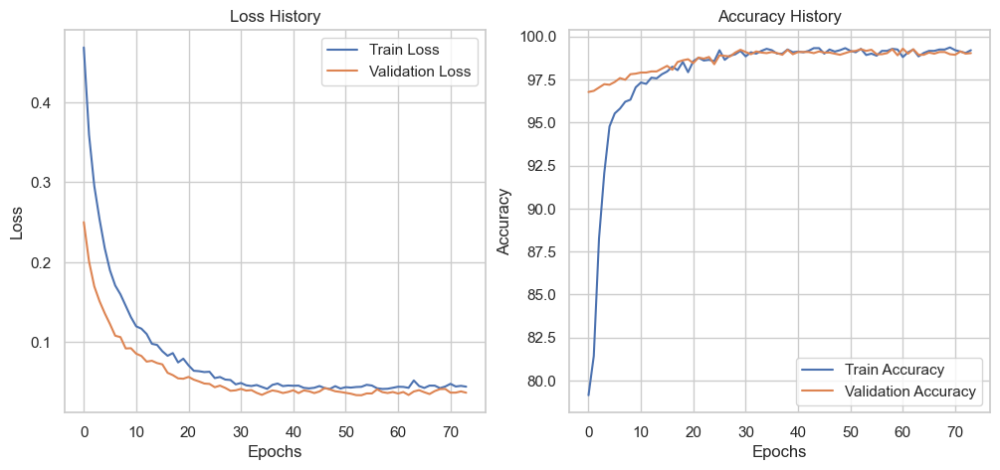

Validation Loss: 0.0338, Accuracy: 99.16%
Final Validation for ResNet50 - Loss: 0.0338, Accuracy: 99.16%

Training EfficientNet_B0
Epoch [1/100] - Train Loss: 0.4960, Train Accuracy: 74.88%, Val Loss: 0.2462, Val Accuracy: 96.90%
Current learning rate: 0.0001
Epoch [2/100] - Train Loss: 0.3184, Train Accuracy: 84.86%, Val Loss: 0.1551, Val Accuracy: 97.35%
Current learning rate: 0.0001
Epoch [3/100] - Train Loss: 0.2468, Train Accuracy: 90.69%, Val Loss: 0.1353, Val Accuracy: 97.90%
Current learning rate: 0.0001
Epoch [4/100] - Train Loss: 0.1973, Train Accuracy: 94.09%, Val Loss: 0.1095, Val Accuracy: 98.61%
Current learning rate: 0.0001
Validation loss decreased (inf to 0.109535). Saving model...
Epoch [5/100] - Train Loss: 0.1653, Train Accuracy: 95.73%, Val Loss: 0.1009, Val Accuracy: 98.68%
Current learning rate: 0.0001
Validation loss decreased (0.109535 to 0.100915). Saving model...
Epoch [6/100] - Train Loss: 0.1502, Train Accuracy: 96.25%, Val Loss: 0.0795, Val Accuracy: 99.00

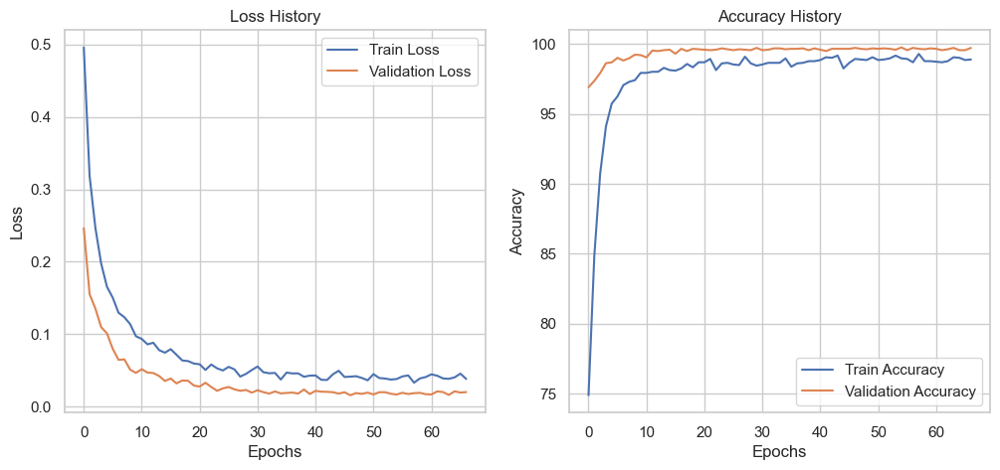

Validation Loss: 0.0155, Accuracy: 99.71%
Final Validation for EfficientNet_B0 - Loss: 0.0155, Accuracy: 99.71%

Training DenseNet121
Epoch [1/100] - Train Loss: 0.4236, Train Accuracy: 79.47%, Val Loss: 0.1976, Val Accuracy: 96.97%
Current learning rate: 0.0001
Epoch [2/100] - Train Loss: 0.3245, Train Accuracy: 84.66%, Val Loss: 0.1440, Val Accuracy: 97.16%
Current learning rate: 0.0001
Epoch [3/100] - Train Loss: 0.2656, Train Accuracy: 88.74%, Val Loss: 0.1215, Val Accuracy: 97.42%
Current learning rate: 0.0001
Epoch [4/100] - Train Loss: 0.2227, Train Accuracy: 92.49%, Val Loss: 0.1138, Val Accuracy: 97.74%
Current learning rate: 0.0001
Validation loss decreased (inf to 0.113810). Saving model...
Epoch [5/100] - Train Loss: 0.1928, Train Accuracy: 93.33%, Val Loss: 0.1086, Val Accuracy: 98.03%
Current learning rate: 0.0001
Validation loss decreased (0.113810 to 0.108583). Saving model...
Epoch [6/100] - Train Loss: 0.1736, Train Accuracy: 94.69%, Val Loss: 0.1004, Val Accuracy: 98

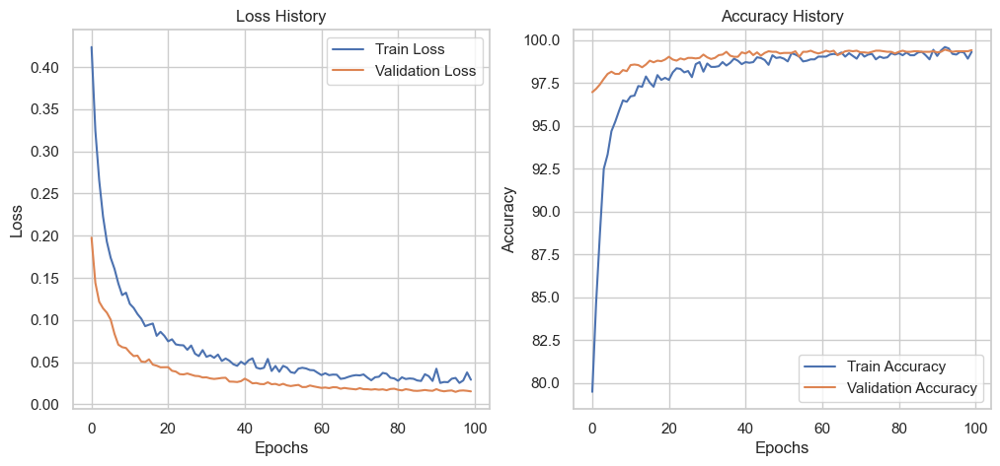

Validation Loss: 0.0147, Accuracy: 99.35%
Final Validation for DenseNet121 - Loss: 0.0147, Accuracy: 99.35%


In [14]:
# Main Model Training loop and Hyper-parameters
import numpy as np
import torch.optim as optim
from collections import namedtuple

# Define a structure for model configurations
ModelConfig = namedtuple('ModelConfig', ['dropout', 'lr', 'weight_decay', 'num_classes'])

model_configs = {
    'MobileNetV2': ModelConfig(dropout=0.5, lr=0.0001, weight_decay=0.0001, num_classes=2),
    'MobileNetV3_Large': ModelConfig(dropout=0.6, lr=0.0001, weight_decay=0.0001, num_classes=2),
    'ResNet50': ModelConfig(dropout=0.2, lr=0.0001, weight_decay=0.0001, num_classes=2),
    'EfficientNet_B0': ModelConfig(dropout=0.2, lr=0.0001, weight_decay=0.0001, num_classes=2),
    'DenseNet121': ModelConfig(dropout=0.2, lr=0.0001, weight_decay=0.0001, num_classes=2)
}
# Load the models
models_dict = load_pretrained_models(model_configs)

for name, components in models_dict.items():
    model = components['model']
    optimizer = components['optimizer']

    print(f"\nTraining {name}")
    criterion = nn.CrossEntropyLoss()

    history = train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=100)
    
    # Plot the history
    plot_history(history)
    
    # Validate the model outside training validation - not necessary, practice has shown the same results
    val_loss, val_accuracy = validate_model(model, criterion, val_loader)
    print(f"Final Validation for {name} - Loss: {val_loss:.4f}, Accuracy: {val_accuracy:.2f}%")


## Generate Predictions and Evaluate Model (not real evaluation - on validation data)


Evaluating MobileNetV2


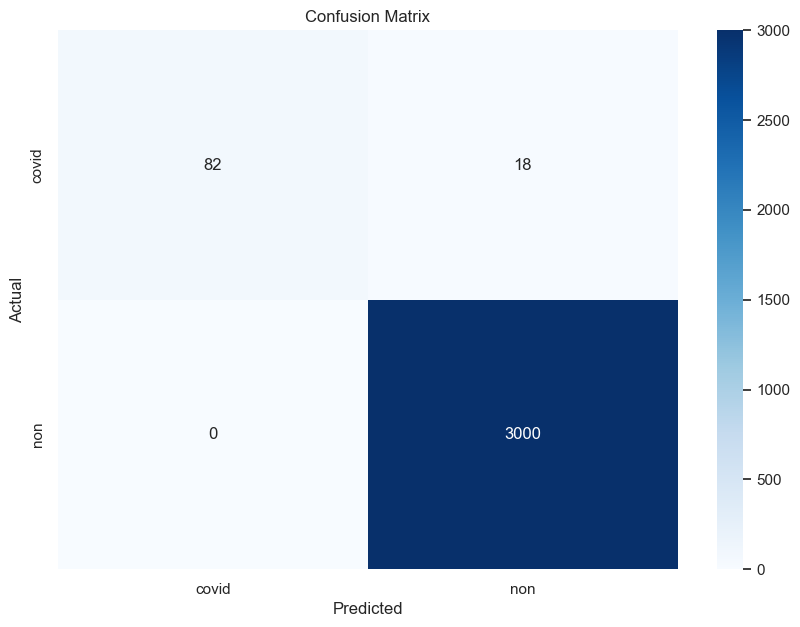

              precision    recall  f1-score   support

       covid       1.00      0.82      0.90       100
         non       0.99      1.00      1.00      3000

    accuracy                           0.99      3100
   macro avg       1.00      0.91      0.95      3100
weighted avg       0.99      0.99      0.99      3100



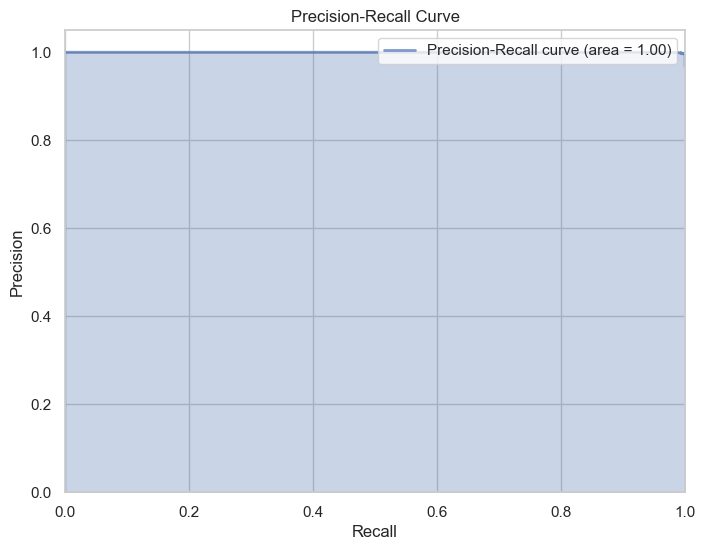

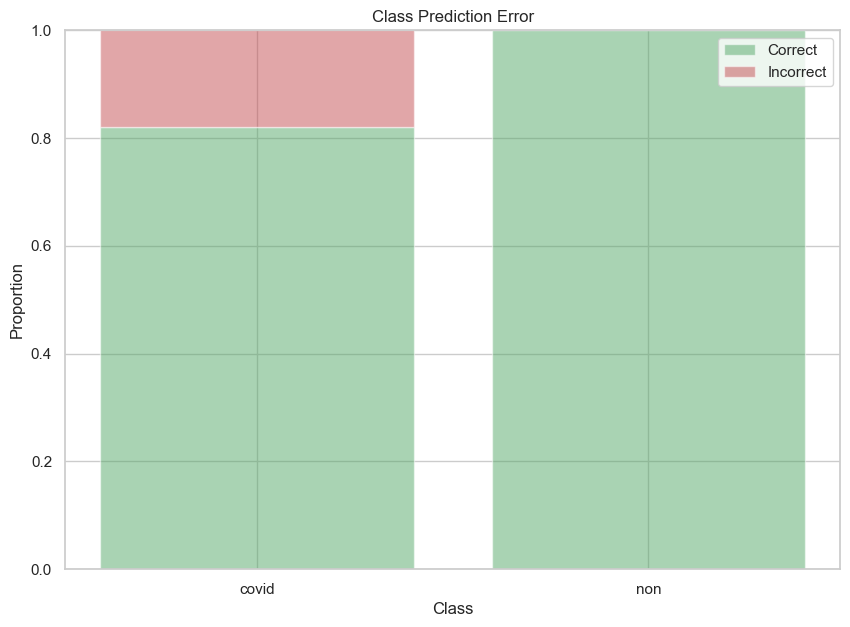

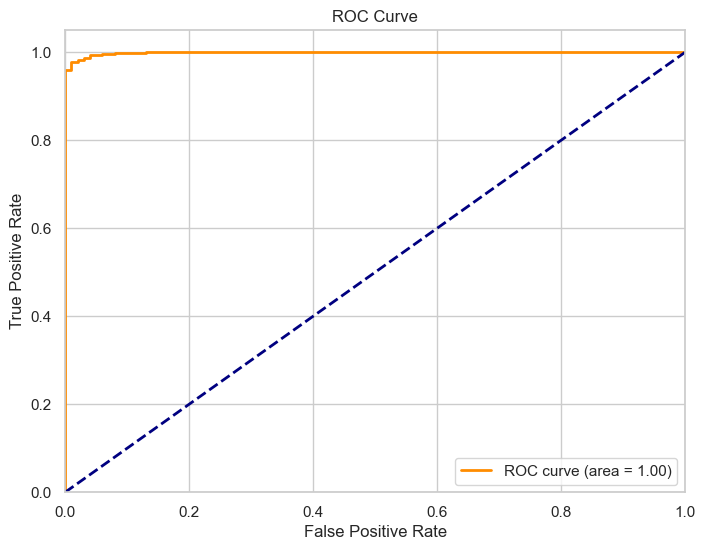

ROC AUC for MobileNetV2: 1.00

Evaluating MobileNetV3_Large


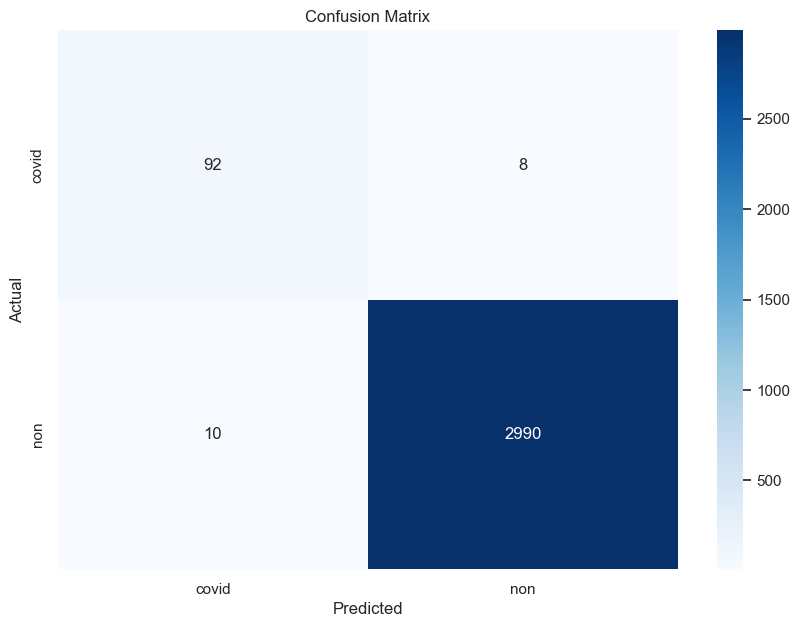

              precision    recall  f1-score   support

       covid       0.90      0.92      0.91       100
         non       1.00      1.00      1.00      3000

    accuracy                           0.99      3100
   macro avg       0.95      0.96      0.95      3100
weighted avg       0.99      0.99      0.99      3100



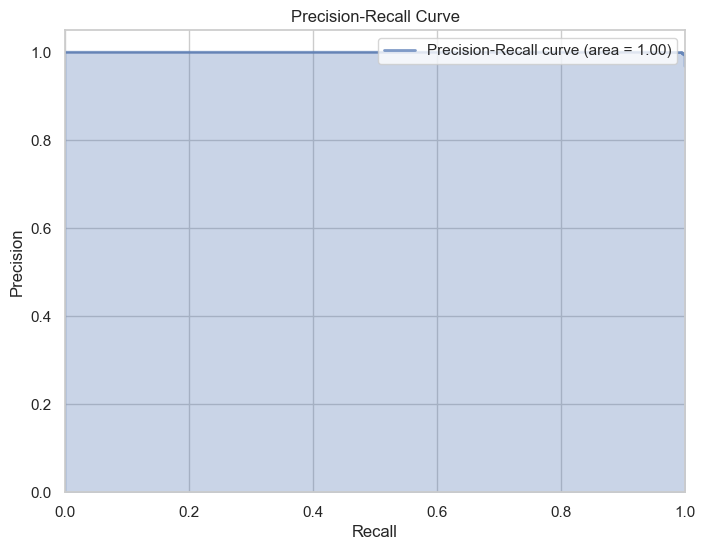

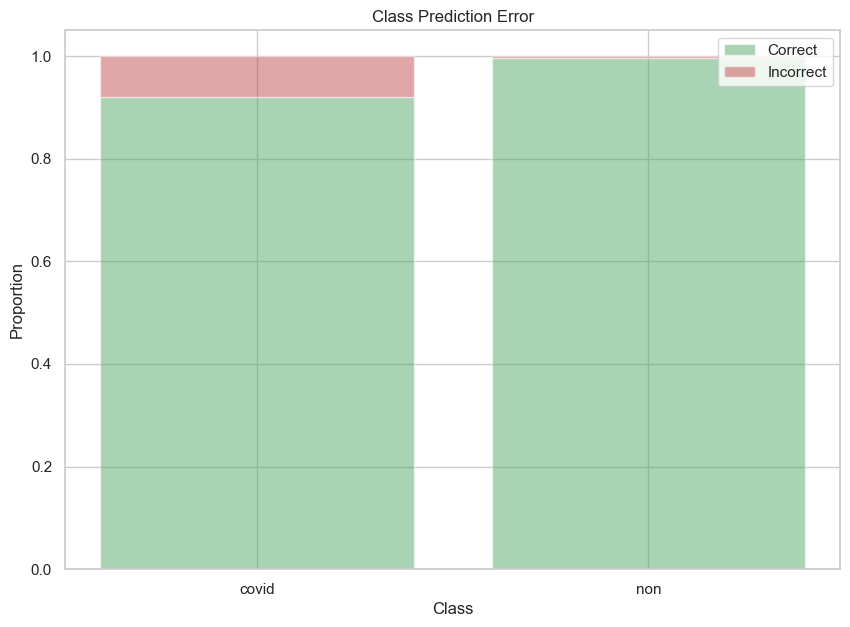

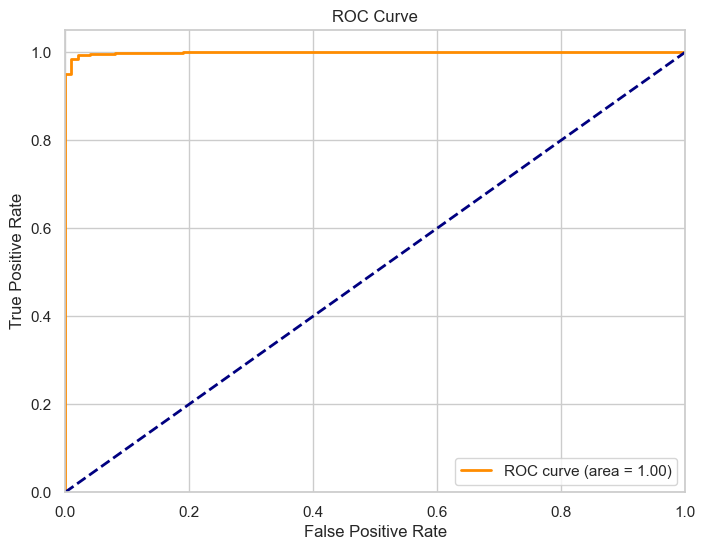

ROC AUC for MobileNetV3_Large: 1.00

Evaluating ResNet50


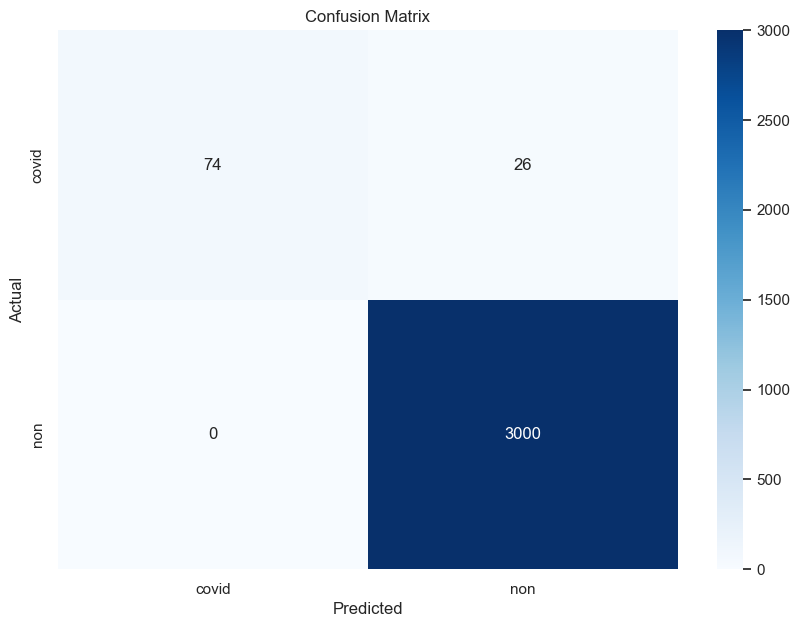

              precision    recall  f1-score   support

       covid       1.00      0.74      0.85       100
         non       0.99      1.00      1.00      3000

    accuracy                           0.99      3100
   macro avg       1.00      0.87      0.92      3100
weighted avg       0.99      0.99      0.99      3100



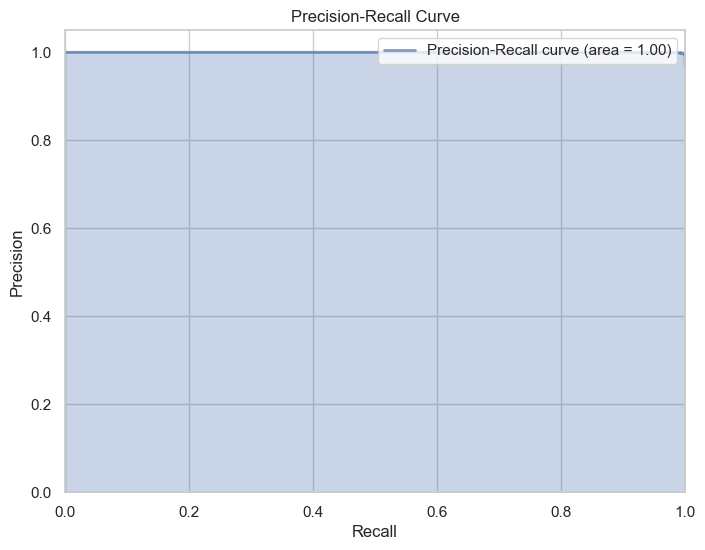

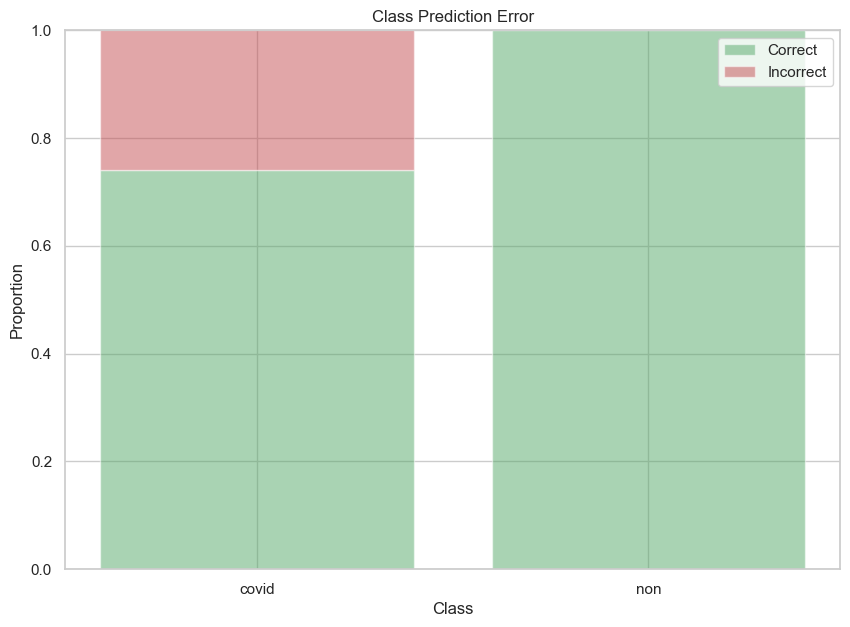

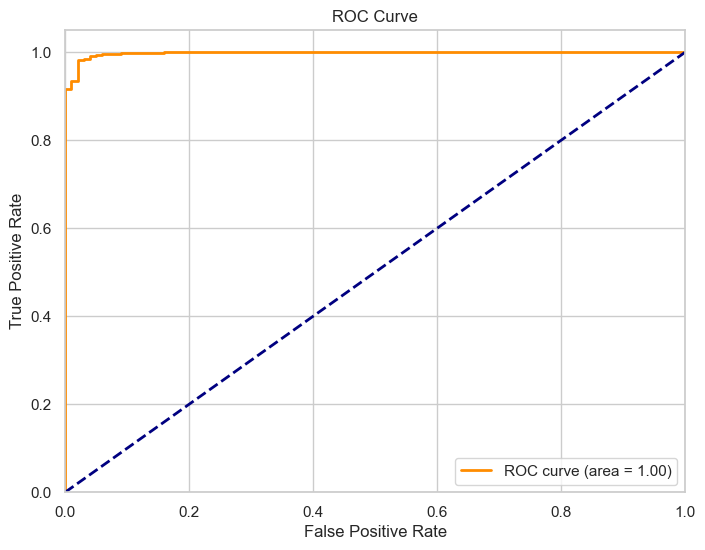

ROC AUC for ResNet50: 1.00

Evaluating EfficientNet_B0


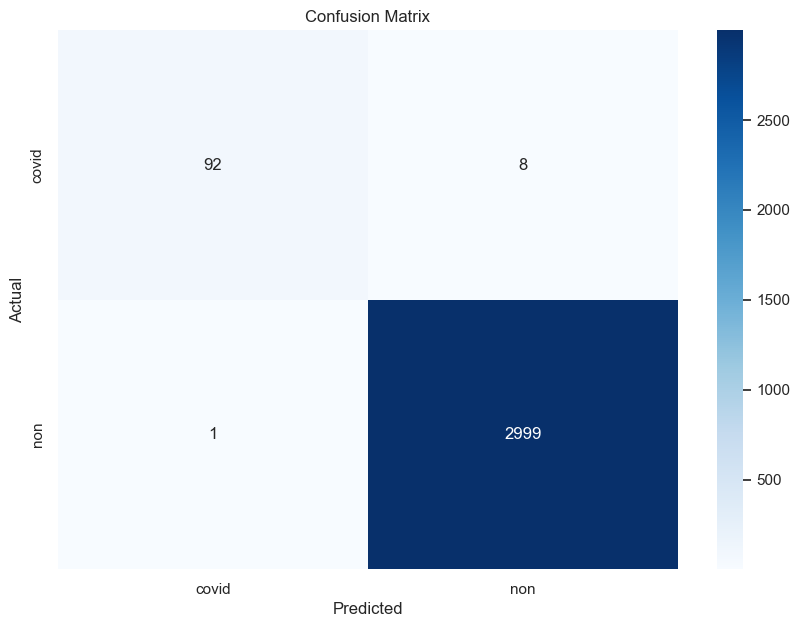

              precision    recall  f1-score   support

       covid       0.99      0.92      0.95       100
         non       1.00      1.00      1.00      3000

    accuracy                           1.00      3100
   macro avg       0.99      0.96      0.98      3100
weighted avg       1.00      1.00      1.00      3100



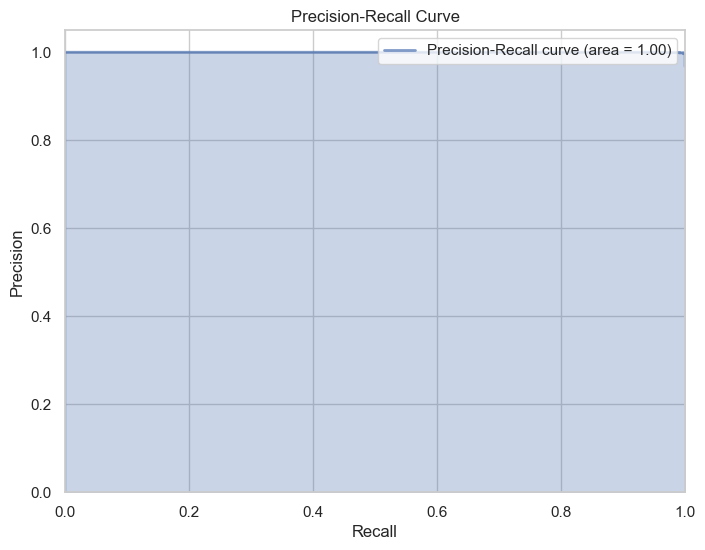

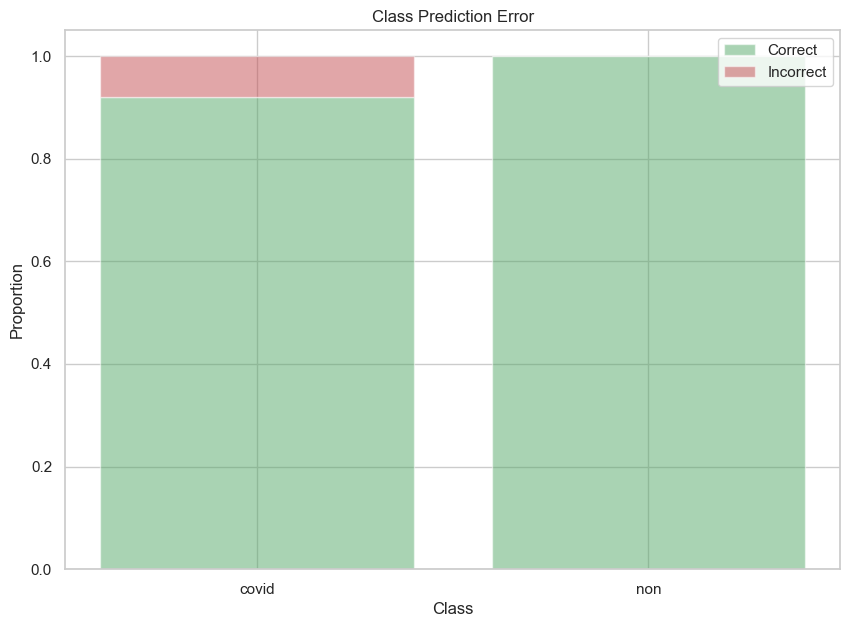

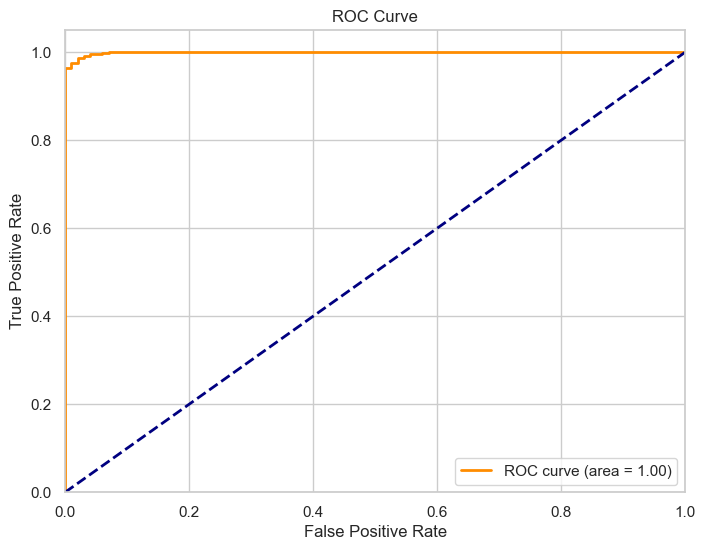

ROC AUC for EfficientNet_B0: 1.00

Evaluating DenseNet121


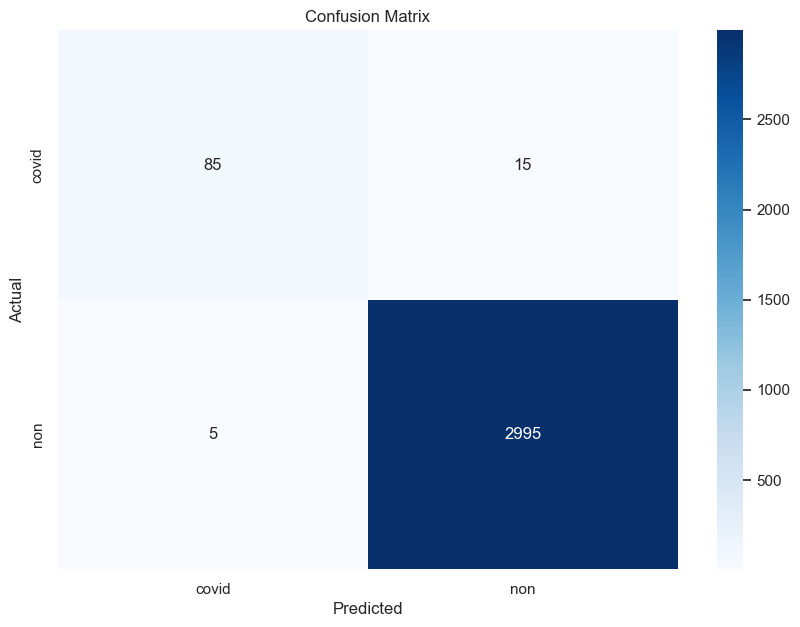

              precision    recall  f1-score   support

       covid       0.94      0.85      0.89       100
         non       1.00      1.00      1.00      3000

    accuracy                           0.99      3100
   macro avg       0.97      0.92      0.95      3100
weighted avg       0.99      0.99      0.99      3100



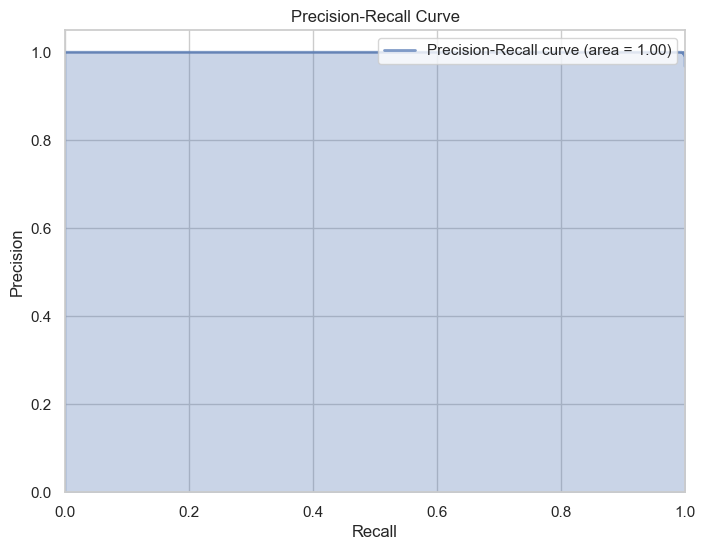

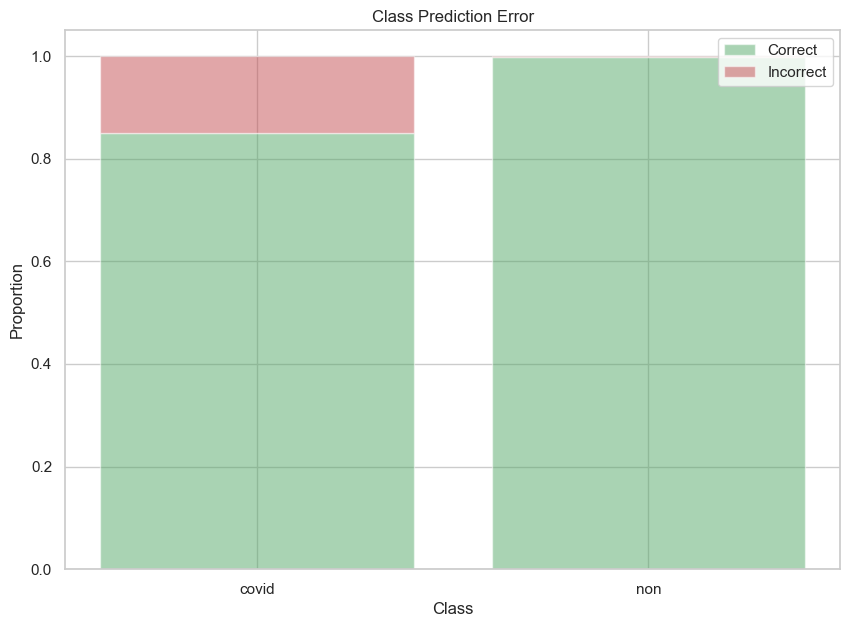

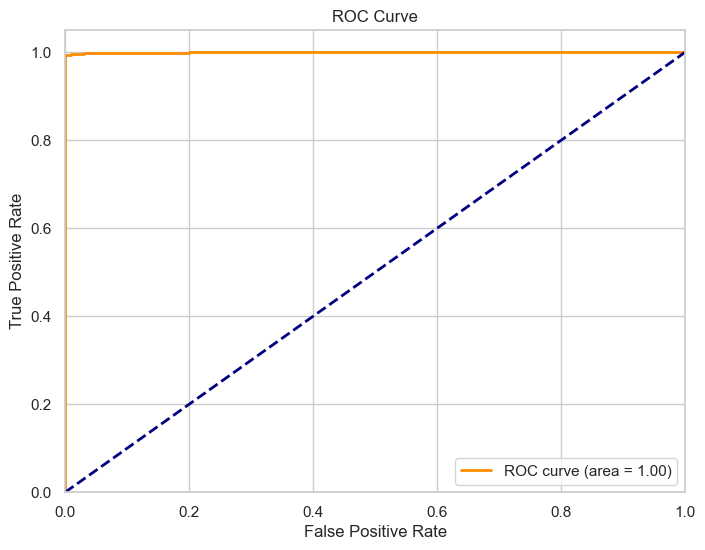

ROC AUC for DenseNet121: 1.00


In [15]:
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc, precision_recall_curve, average_precision_score

def evaluate_model_full(model, data_loader, device):
    """ Evaluate the model on the given data loader and calculate metrics for classification. """
    model.eval()
    actuals, predictions, scores = [], [], []
    with torch.no_grad():
        for images, labels in data_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            actuals.extend(labels.cpu().numpy())
            predictions.extend(predicted.cpu().numpy())
            scores.extend(outputs.softmax(dim=1)[:,1].cpu().numpy())

    return actuals, predictions, scores

def plot_confusion_matrix(actuals, predictions, classes):
    """ Plot the confusion matrix. """
    cm = confusion_matrix(actuals, predictions)
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()

def plot_roc_curve(actuals, scores, title='ROC Curve'):
    """ Plot the ROC curve and calculate AUC. """
    fpr, tpr, thresholds = roc_curve(actuals, scores)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(title)
    plt.legend(loc="lower right")
    plt.show()
    return roc_auc

def plot_precision_recall_curve(actuals, scores):
    """Plot the Precision-Recall curve for the model."""
    precision, recall, thresholds = precision_recall_curve(actuals, scores)
    average_precision = average_precision_score(actuals, scores)

    plt.figure(figsize=(8, 6))
    plt.step(recall, precision, where='post', color='b', alpha=0.7, linestyle='-', linewidth=2,
             label=f'Precision-Recall curve (area = {average_precision:.2f})')
    plt.fill_between(recall, precision, step='post', alpha=0.3, color='b')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title('Precision-Recall Curve')
    plt.legend(loc="upper right")
    plt.show()

def plot_class_prediction_error(actuals, predictions, classes):
    """Plot the Class Prediction Error bars."""
    cm = confusion_matrix(actuals, predictions)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    plt.figure(figsize=(10, 7))
    plt.bar(range(len(classes)), cm_normalized.diagonal(), alpha=0.5, color='g', label='Correct')
    plt.bar(range(len(classes)), 1 - cm_normalized.diagonal(), alpha=0.5, color='r', label='Incorrect', bottom=cm_normalized.diagonal())
    plt.xticks(range(len(classes)), classes)
    plt.xlabel('Class')
    plt.ylabel('Proportion')
    plt.title('Class Prediction Error')
    plt.legend(loc="upper right")
    plt.show()

def print_classification_report(actuals, predictions, classes):
    """ Print the classification report. """
    print(classification_report(actuals, predictions, target_names=classes))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for name, components in models_dict.items():
    print(f"\nEvaluating {name}")
    model = components['model'].to(device)
    
    actuals, predictions, scores = evaluate_model_full(model, val_loader, device)
    classes = val_loader.dataset.classes  # Ensure your dataset has a 'classes' attribute
    
    plot_confusion_matrix(actuals, predictions, classes)
    print_classification_report(actuals, predictions, classes)
    plot_precision_recall_curve(actuals, scores)
    plot_class_prediction_error(actuals, predictions, classes)
    roc_auc = plot_roc_curve(actuals, scores)
    print(f"ROC AUC for {name}: {roc_auc:.2f}")


In [16]:
models_dict

{'MobileNetV2': {'model': MobileNetV2(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (1): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU6(inplace=True)
          )
          (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (2): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 96, kernel_size=(1

# Test Models with new images and visualise results

In [198]:
#Supress default INFO logging
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)


In [199]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class SimpleImageDataset(Dataset):
    def __init__(self, directory, transform=None):
        """
        Args:
            directory (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.directory = directory
        self.transform = transform
        self.image_files = [f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.image_files[idx])
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)

        return image, img_name

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

dataset = SimpleImageDataset('new_images', transform=transform)
dataloader = DataLoader(dataset, batch_size=4, shuffle=False)

for images, image_names in dataloader:
    print(image_names)


('new_images\\Covid_from_test_dataset_1.jpeg', 'new_images\\Covid_from_test_dataset_2.jpg', 'new_images\\Covid_from_test_dataset_3.jpg', 'new_images\\Covid_from_test_dataset_4.jpg')
('new_images\\Covid_from_test_dataset_5.png', 'new_images\\Covid_from_test_dataset_6.jpg', 'new_images\\Covid_from_train_dataset_1.jpeg', 'new_images\\Covid_from_train_dataset_2.jpeg')
('new_images\\Covid_from_train_dataset_3.jpeg', 'new_images\\Covid_from_train_dataset_4.png', 'new_images\\Covid_from_train_dataset_5.jpeg', 'new_images\\NEW_astma.jpg')
('new_images\\NEW_BCH-covid-2-days_16_yers_old.jpeg', 'new_images\\NEW_covid.jpg', 'new_images\\NEW_lung cancer.jpg', 'new_images\\NEW_normal.jpg')
('new_images\\NEW_norma_vs_covid.jpeg', 'new_images\\NEW_pneumonia.jpeg', 'new_images\\NEW_smoker.jpg', 'new_images\\NEW_tuberculosis.jpg')


In [200]:
# Dictionary mapping model names to their specific layers for Grad-CAM
grad_cam_layers = {
    'MobileNetV2': 'features.18.0',
    'MobileNetV3_Large': 'features.16.0',
    'ResNet50': 'layer4.2',
    'EfficientNet_B0': 'features.8.0',
    'DenseNet121': 'features.denseblock4.denselayer16.conv2'
}


In [201]:
%%capture

import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class GradCAM:
    def __init__(self, model, layer_name):
        self.model = model.to(device)
        self.layer_name = layer_name
        self.feature_map = None
        self.gradient = None
        layer = dict([*self.model.named_modules()])[layer_name]
        layer.register_forward_hook(self.save_feature_map)
        layer.register_backward_hook(self.save_gradient)

    def save_feature_map(self, module, input, output):
        self.feature_map = output.detach()

    def save_gradient(self, module, grad_input, grad_output):
        if grad_output[0] is not None:
            self.gradient = grad_output[0].detach()

    def generate_heatmap(self, class_idx: int):
        if self.gradient is None or self.feature_map is None:
            raise ValueError("Gradient or feature map is missing - check your hook setup and layer compatibility.")
        
        weights = torch.mean(self.gradient, dim=(0, 2, 3), keepdim=True)
        weighted_feature_map = torch.mul(self.feature_map, weights).sum(dim=1, keepdim=True)
        relu = F.relu(weighted_feature_map.squeeze()).cpu().numpy()
        heatmap = np.maximum(relu, 0)
        heatmap /= np.max(heatmap) if np.max(heatmap) > 0 else 1
        heatmap = np.uint8(255 * heatmap)
        return heatmap

    def __call__(self, x: torch.Tensor, class_idx: int):
        self.model.train()
        x.requires_grad_(True)
        output = self.model(x)
        if not output.requires_grad:
            raise ValueError("Output does not require gradients. Check model layers.")

        class_score = output[:, class_idx]
        self.model.zero_grad()
        class_score.backward()

        if self.gradient is None:
            raise ValueError("No gradients captured. Ensure backward hook is set correctly and model configuration is proper for gradient flow.")

        heatmap = self.generate_heatmap(class_idx)
        self.model.eval()
        return heatmap

In [202]:
def visualize(image: np.ndarray, heatmap: np.ndarray, title: str, image_name: str, alpha: float = 0.5, cmap: str = 'jet'):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(image)
    axes[0].axis('off')
    axes[0].set_title('Original Image')
    
    axes[1].imshow(image)
    axes[1].imshow(heatmap, alpha=alpha, cmap=cmap)
    axes[1].axis('off')
    axes[1].set_title('Heatmap Overlay')
    
    plt.suptitle(title + '\n' + image_name, fontsize=16)
    plt.show()

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


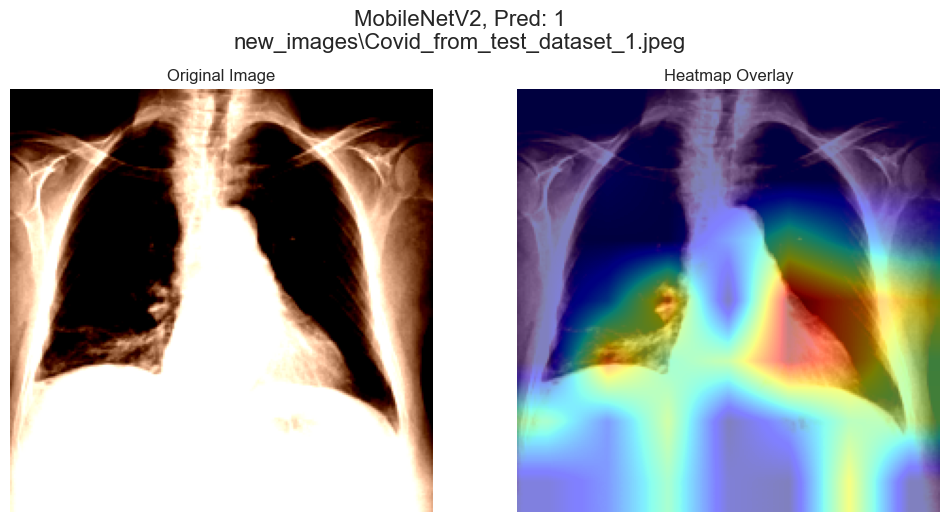

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


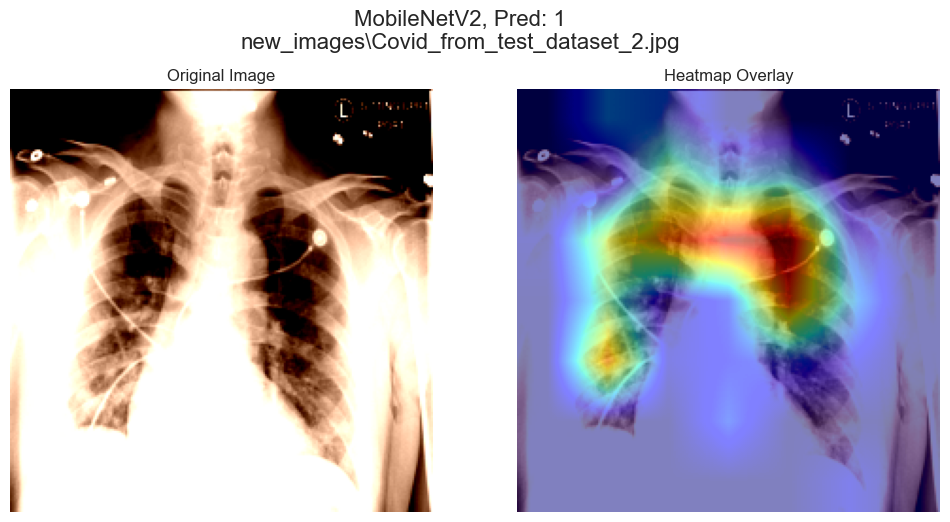

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


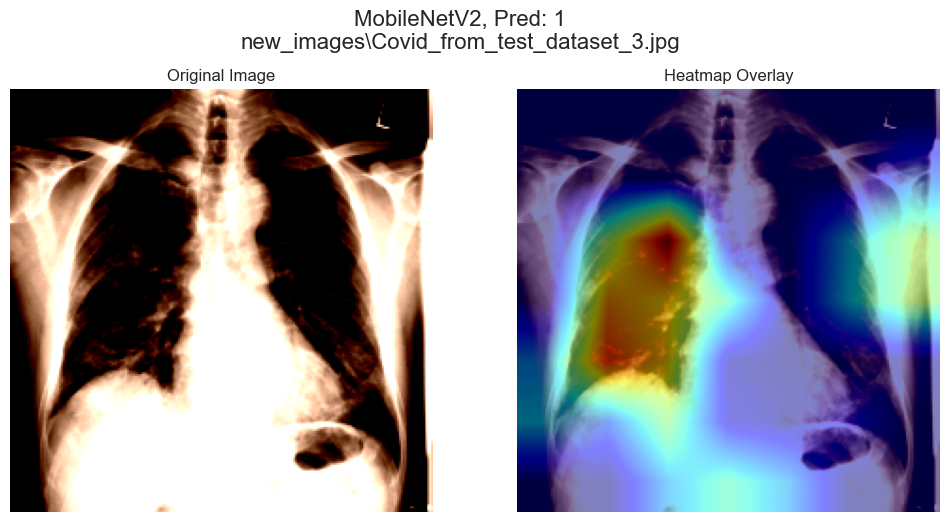

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


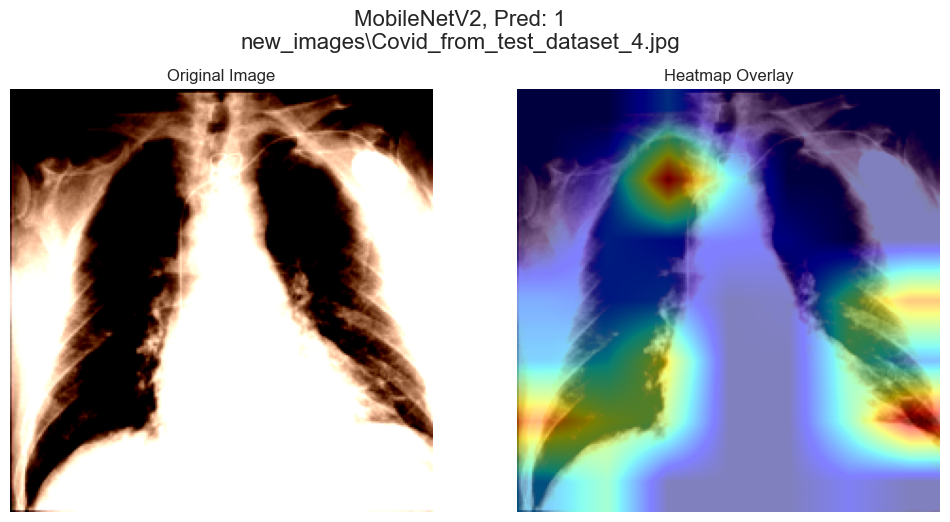

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


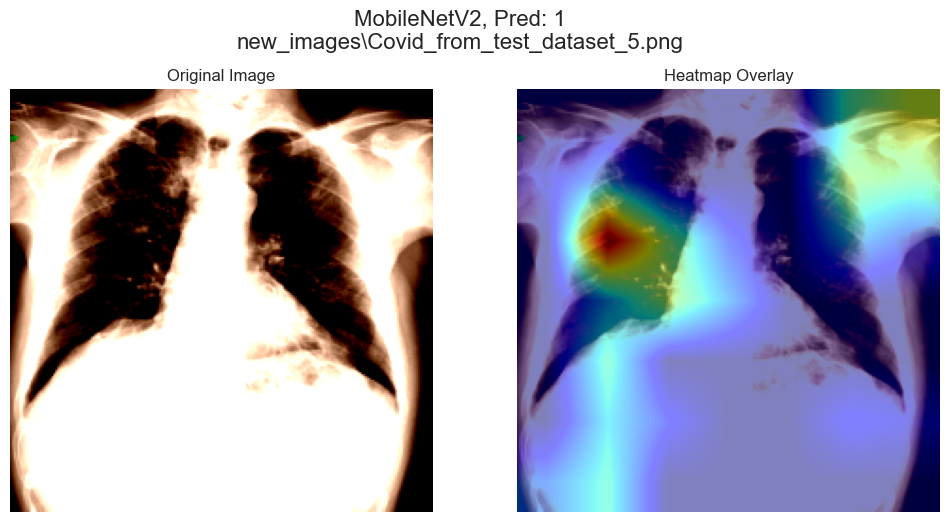

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


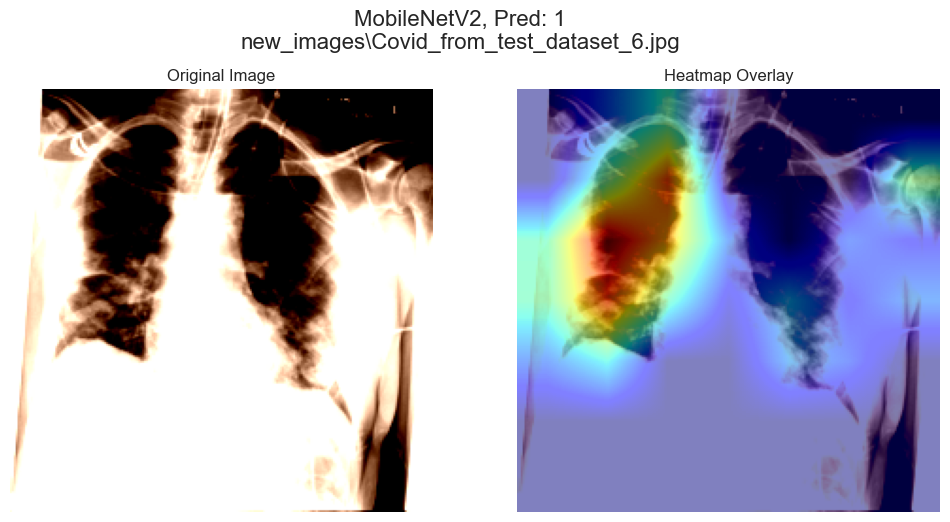

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


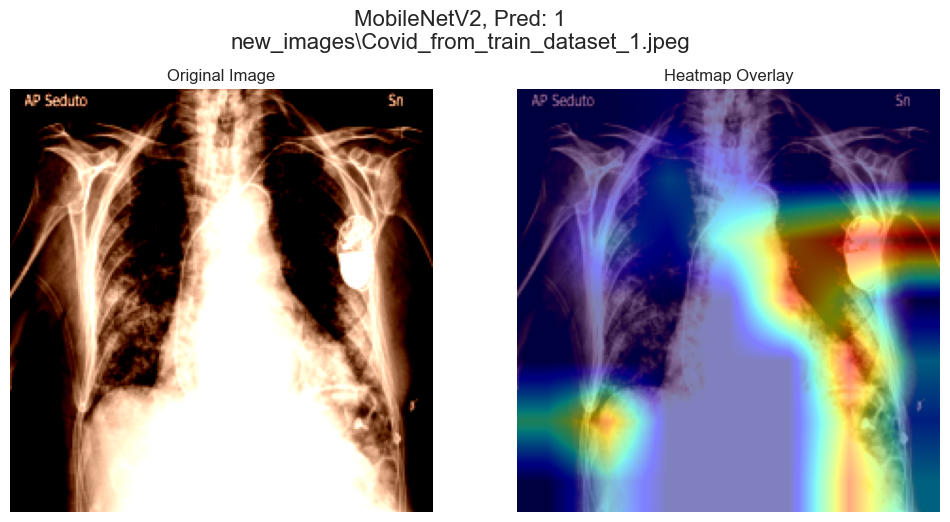

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


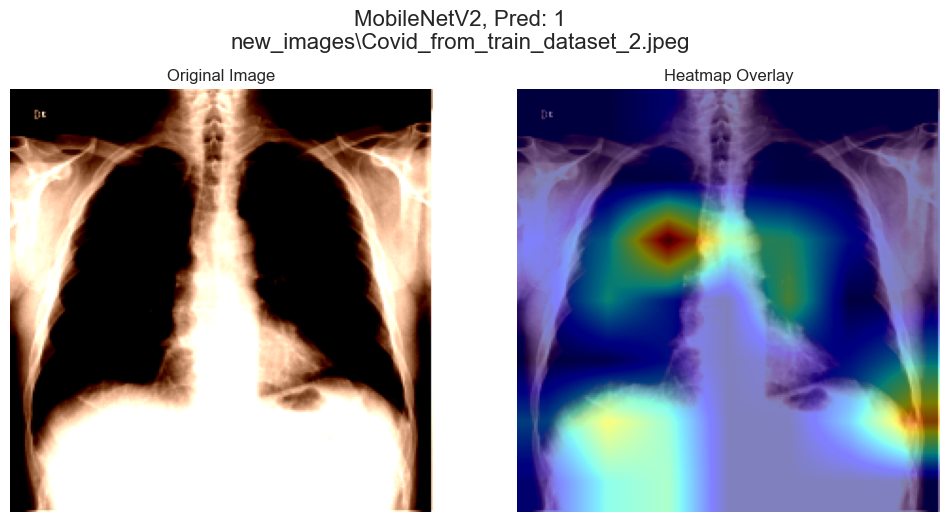

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


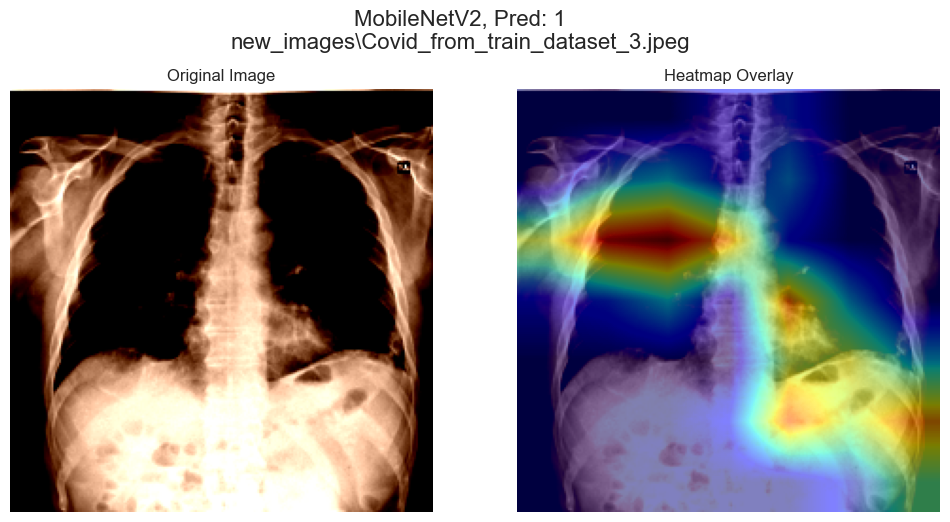

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


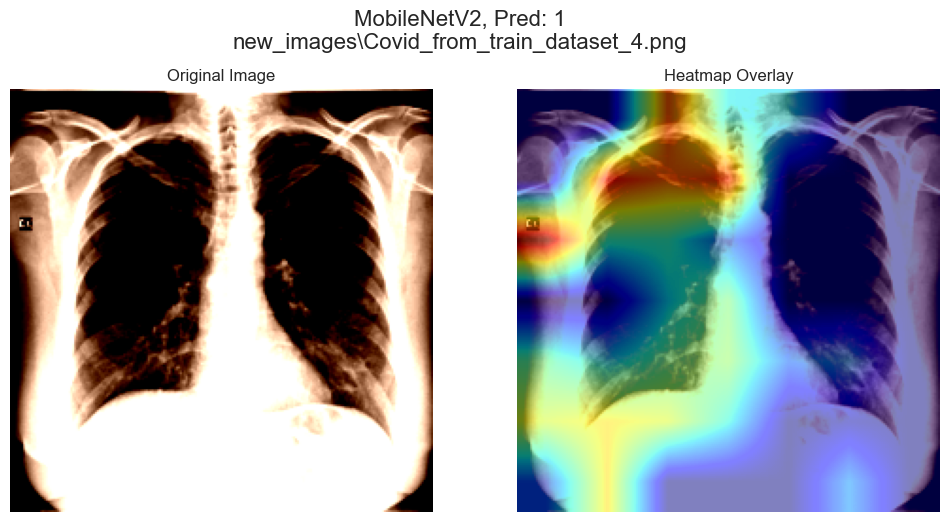

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


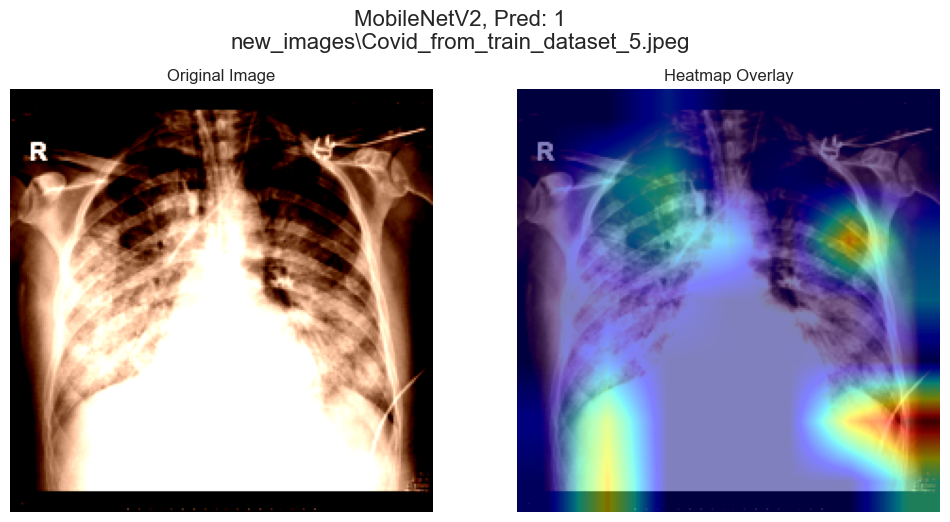

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


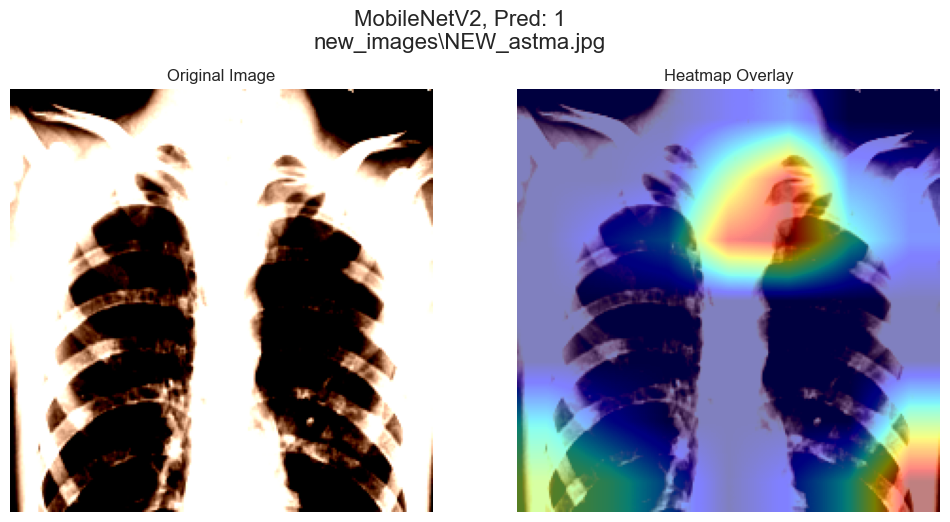

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


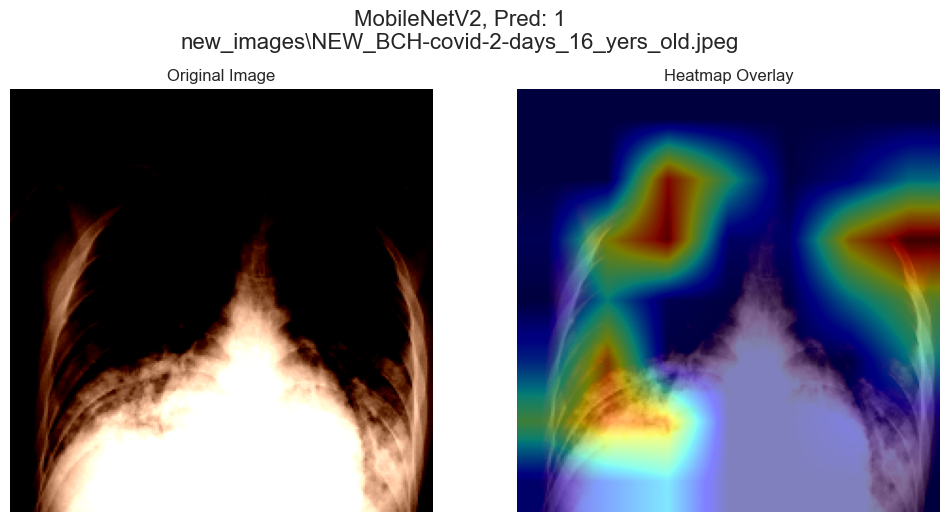

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


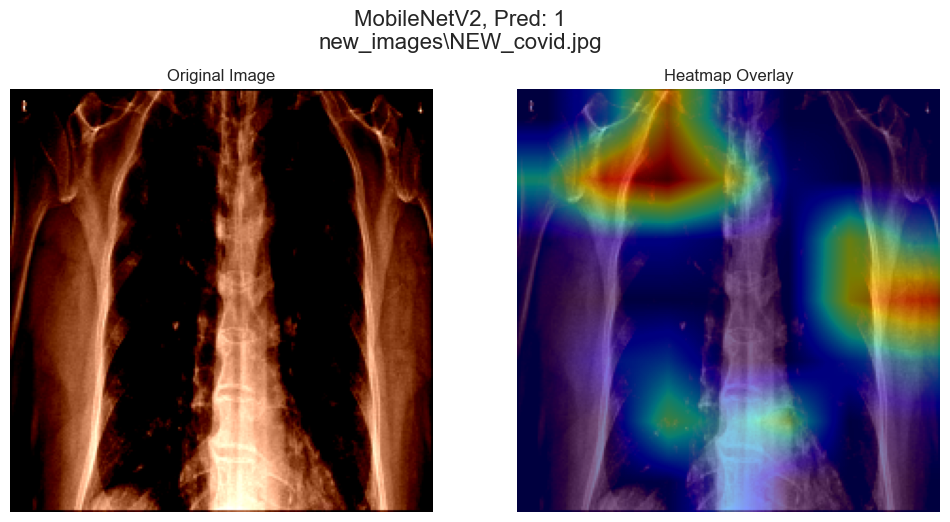

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


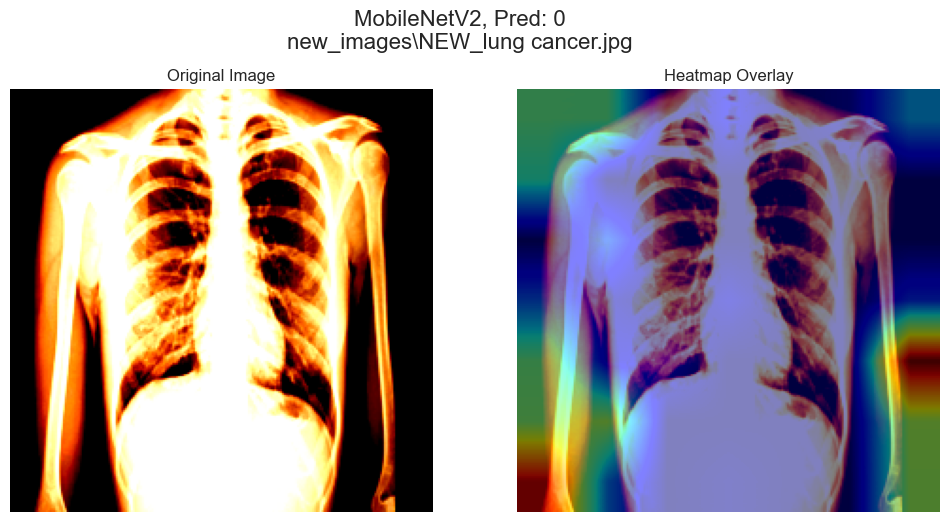

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


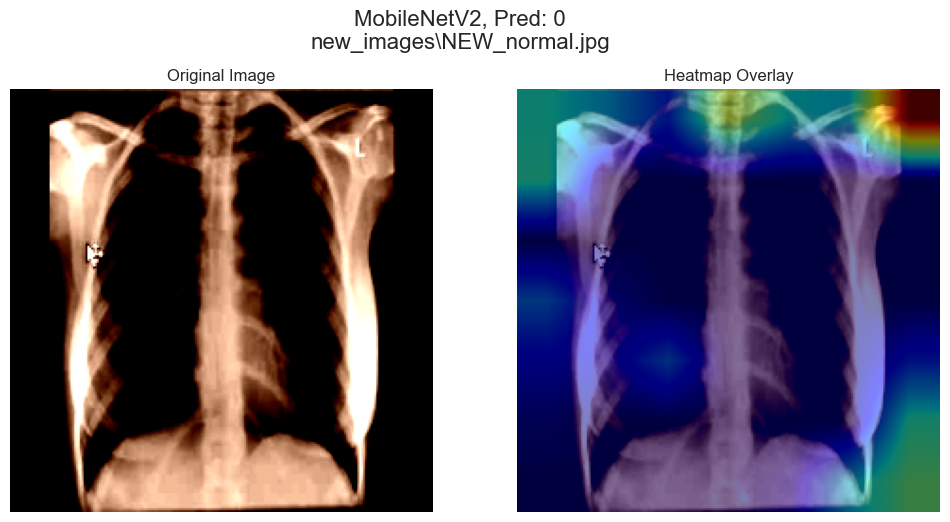

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


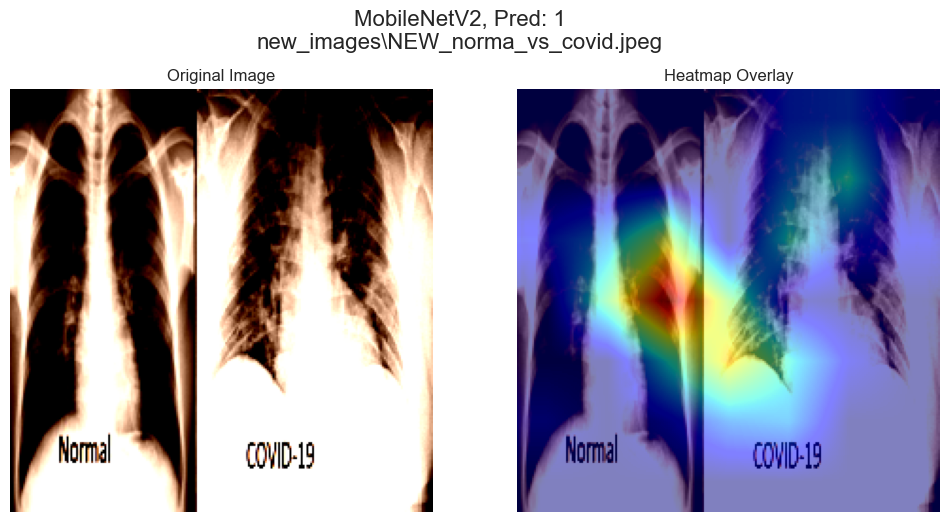

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


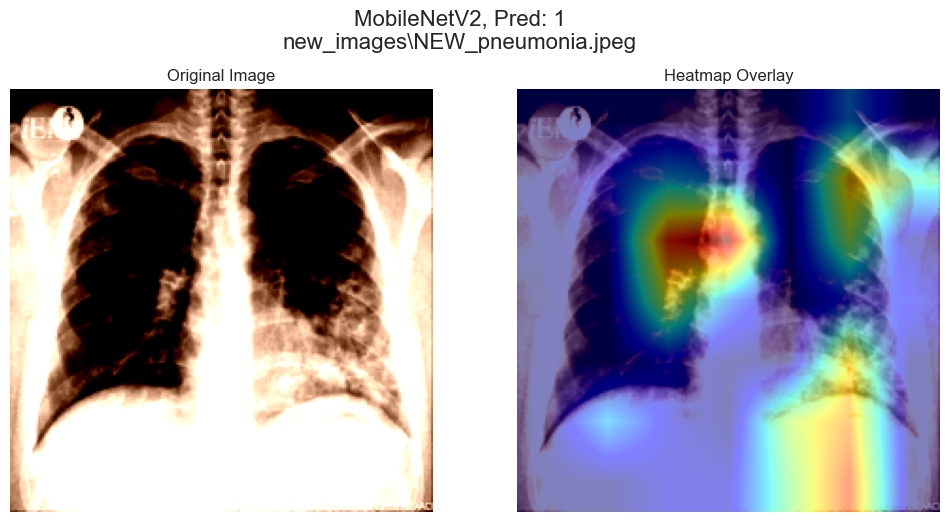

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


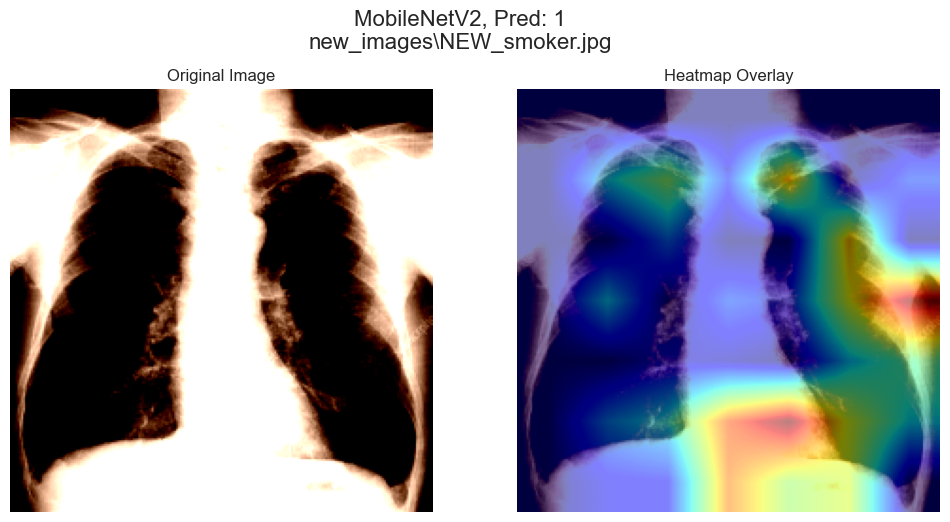

Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Forward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered
Backward hook triggered


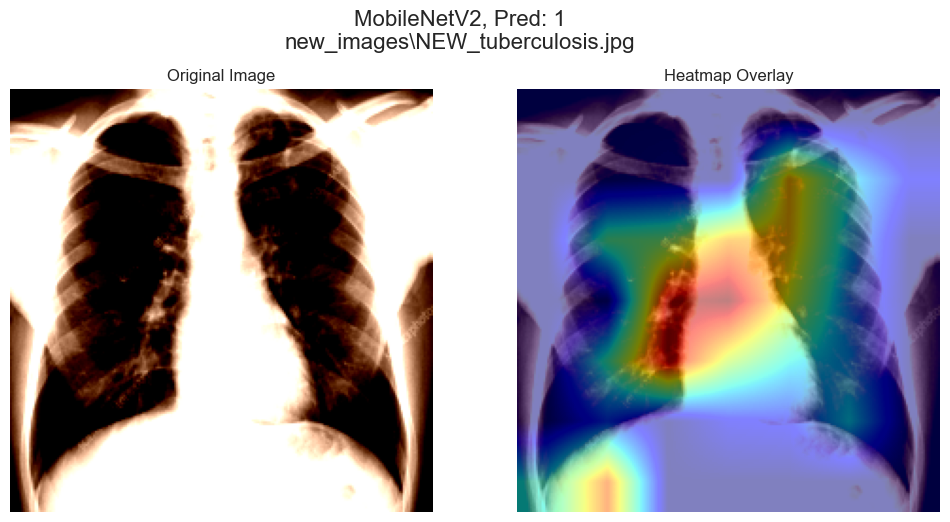

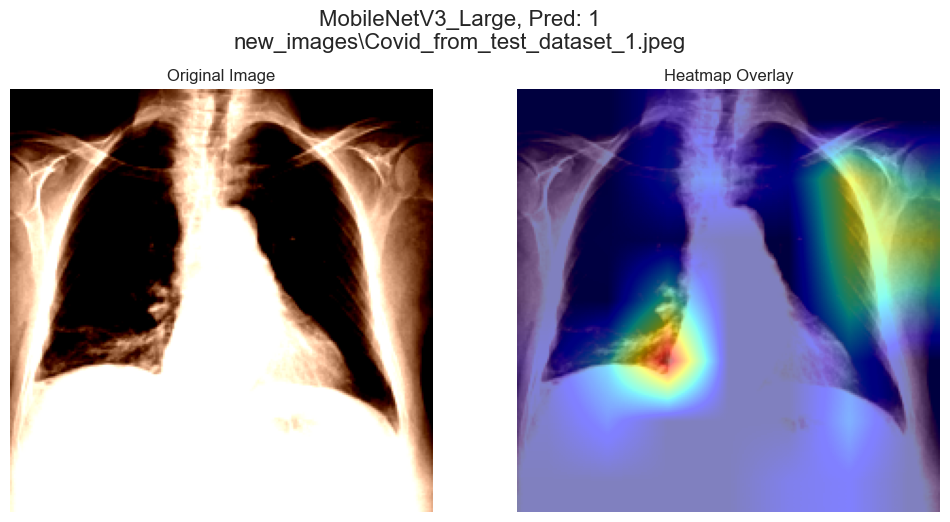

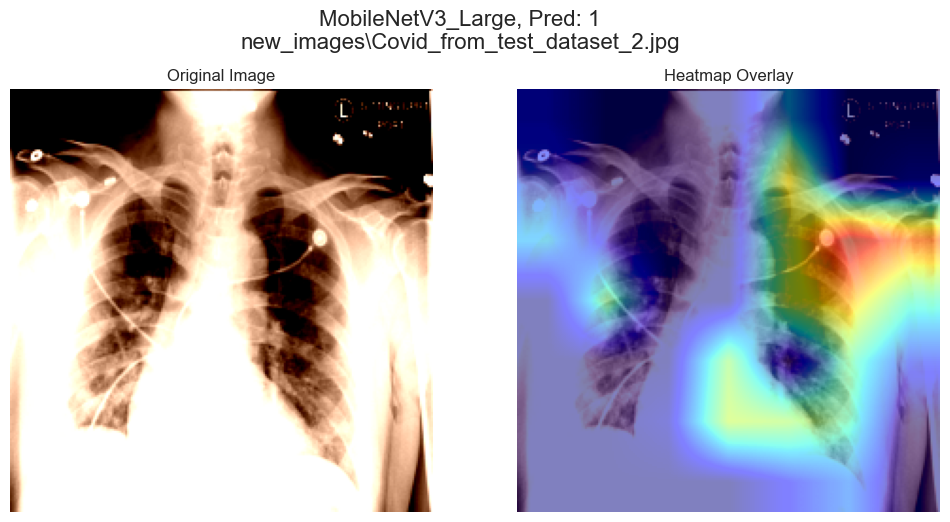

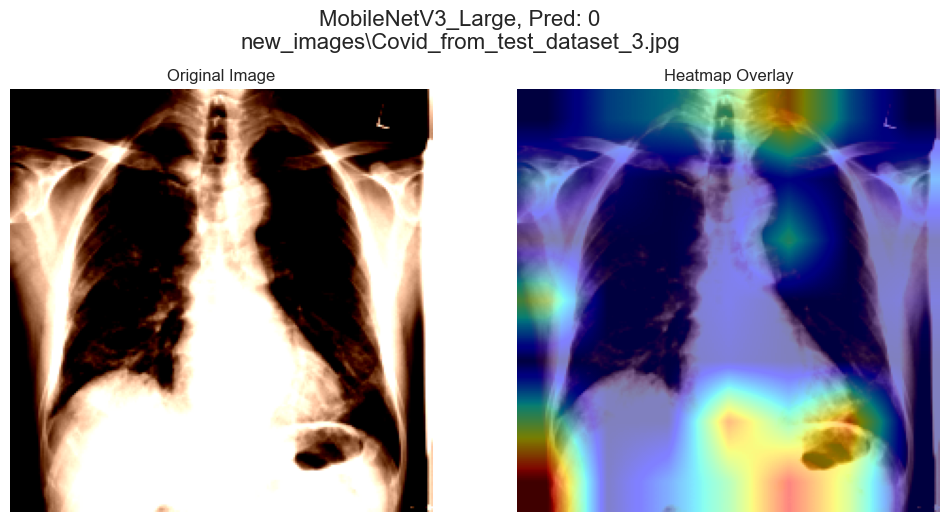

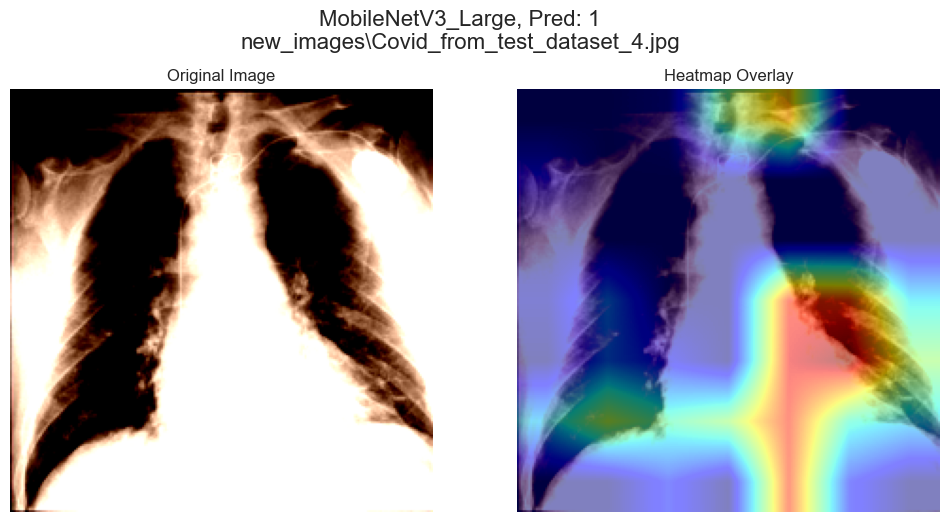

...

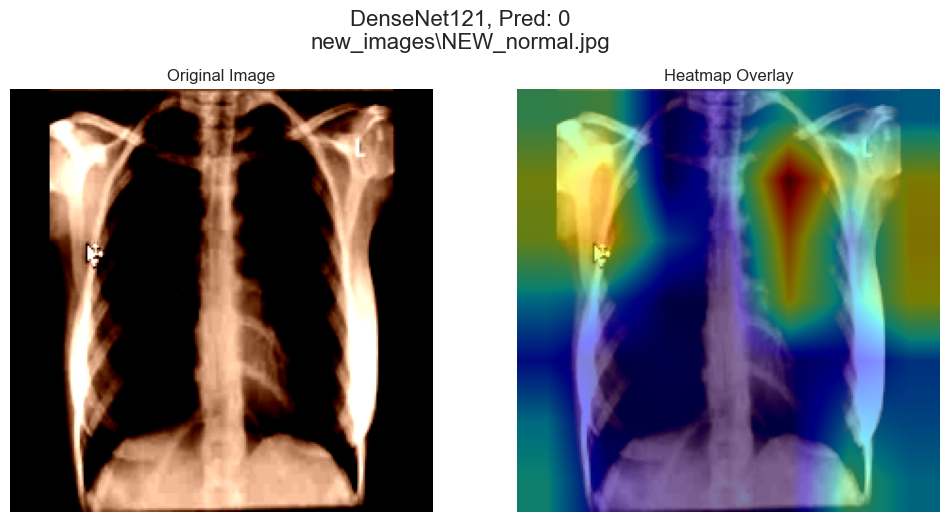

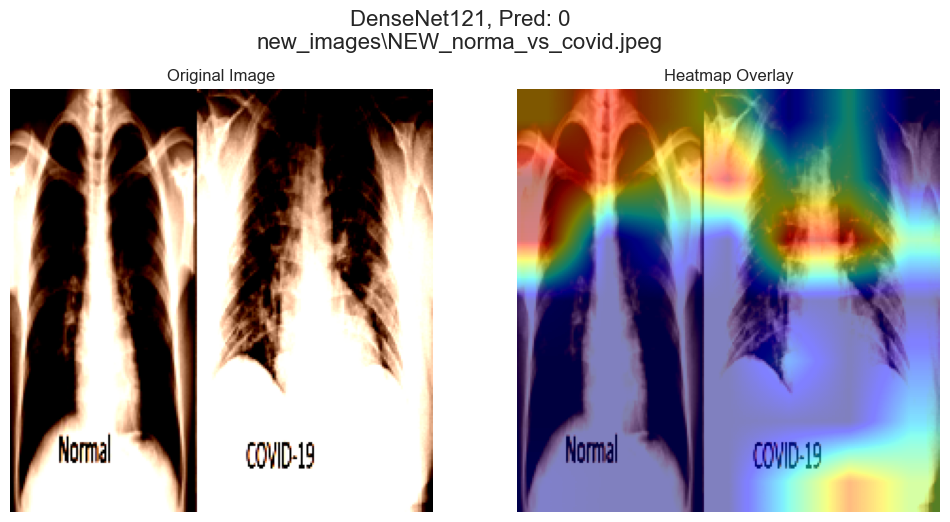

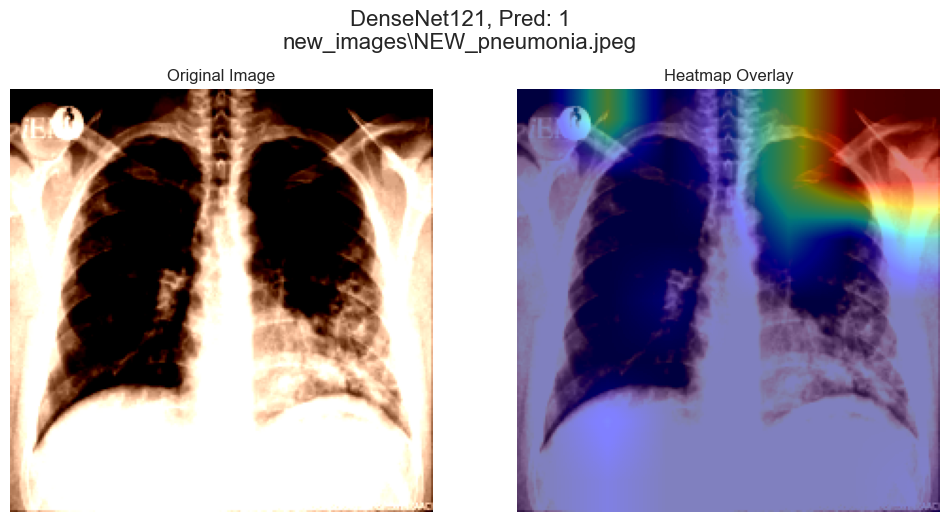

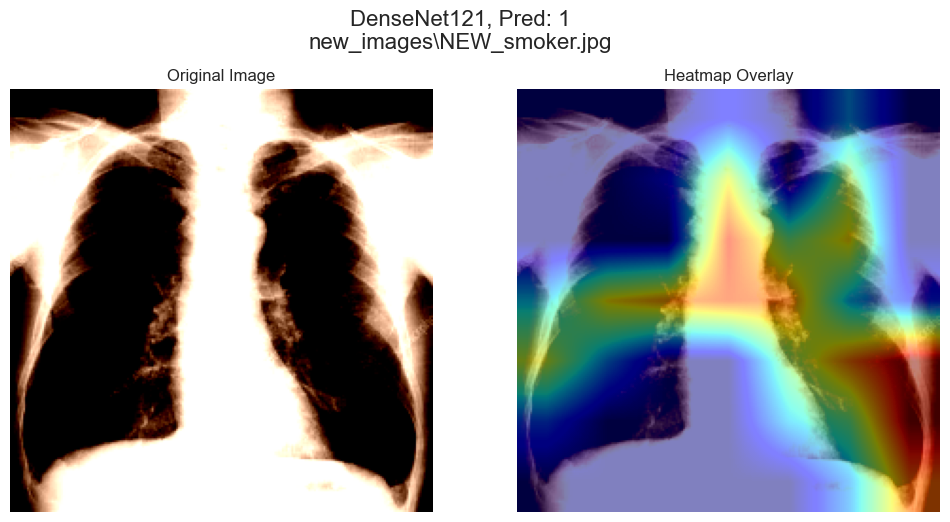

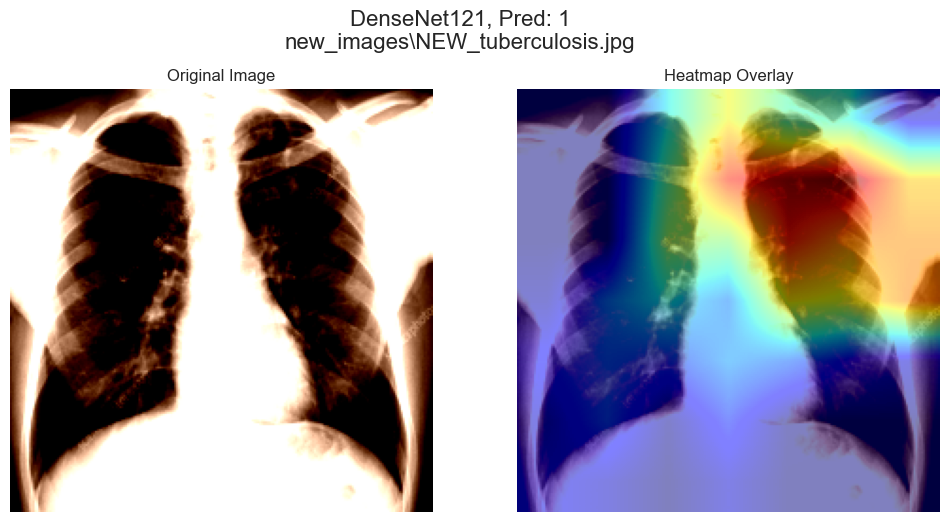

In [203]:
# The loop to pass the image name to the visualize function
for model_name, model_info in models_dict.items():
    model = model_info['model'].to(device)
    model.eval()
    grad_cam = GradCAM(model, grad_cam_layers[model_name])

    for images, image_names in dataloader:
        images = images.to(device)
        outputs = model(images)
        _, predictions = torch.max(outputs, 1)

        for i in range(images.size(0)):
            img_tensor = images[i]
            prediction = predictions[i]
            class_idx = prediction.item()

            model.train()
            heatmap = grad_cam(img_tensor.unsqueeze(0), class_idx)
            model.eval()

            heatmap = cv2.resize(heatmap, (224, 224))
            image_for_plot = img_tensor.detach().cpu().numpy()
            image_for_plot = cv2.cvtColor(image_for_plot.transpose(1, 2, 0), cv2.COLOR_BGR2RGB)

            visualize(image_for_plot, heatmap, f'{model_name}, Pred: {class_idx}', image_names[i])

## Save Models

In [204]:
import json

def save_models(models_dict, save_directory):
    
    if not os.path.exists(save_directory):
        os.makedirs(save_directory)

    for model_name, model_info in models_dict.items():
        model = model_info['model']
        
        # Saving the model weights (state dictionary)
        weights_path = os.path.join(save_directory, f"{model_name}_weights.pth")
        torch.save(model.state_dict(), weights_path)
        
        # Saving the model architecture
        architecture_path = os.path.join(save_directory, f"{model_name}_architecture.json")
        model_info_to_save = {
            'class_name': model.__class__.__name__,
            'state_dict_path': weights_path
        }
        with open(architecture_path, 'w') as f:
            json.dump(model_info_to_save, f)

# Specify the directory to save the models
save_directory = "./saved_models/"

# Save the models
save_models(models_dict, save_directory)
